In [11]:
pwd

'/orange/adamginsburg/cmz/DataSetVisualizations'

In [12]:
%matplotlib inline
import pylab as pl
import numpy as np
pl.rcParams['image.interpolation'] = 'nearest'

In [13]:
import os
from astropy.utils.data import download_file
from astropy.io import fits
from spectral_cube import SpectralCube
from astropy.visualization import simple_norm
import shutil
import reproject
from reproject import reproject_from_healpix, reproject_to_healpix

from astropy.wcs import WCS
import matplotlib.pyplot as plt
from astropy.visualization.wcsaxes.frame import EllipticalFrame
import astropy.visualization.wcsaxes

from matplotlib.colors import rgb_to_hsv, hsv_to_rgb 

from astropy import coordinates
from astropy.coordinates import SkyCoord
from astropy import units as u, constants
from astropy.convolution import convolve_fft, Gaussian2DKernel, Gaussian1DKernel
import healpy
import PIL
import pyavm
import regions

In [14]:
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes, inset_axes, mark_inset

In [15]:
from mpl_toolkits.axes_grid1.inset_locator import TransformedBbox, BboxPatch, BboxConnector, Path
from astropy import wcs
from matplotlib.transforms import Bbox
from matplotlib.patches import Polygon, PathPatch, ConnectionPatch

def mark_inset_generic(axins, parent_ax, data, loc1=1, loc2=3,
                       loc1in=None, loc2in=None, edgecolor='b', zorder1=100, zorder2=100, polyzorder=1):
    bl = axins.wcs.pixel_to_world(0, 0)
    br = axins.wcs.pixel_to_world(data.shape[1], 0)
    tl = axins.wcs.pixel_to_world(0, data.shape[0]) # x,y not y,x
    tr = axins.wcs.pixel_to_world(data.shape[1], data.shape[0]) # x,y not y,x
    
    fig = parent_ax.get_figure()
    
    #frame = parent_ax.wcs.wcs.radesys.lower()
    #frame = ax.wcs.world_axis_physical_types[0].split(".")[1]
    frame = wcs.utils.wcs_to_celestial_frame(ax.wcs)
    
    blt = bl.transform_to(frame)
    brt = br.transform_to(frame)
    tlt = tl.transform_to(frame)
    trt = tr.transform_to(frame)
    xys = [parent_ax.wcs.wcs_world2pix([[crd.spherical.lon.deg,
                                         crd.spherical.lat.deg]],0)[0]
           for crd in (trt, tlt, blt, brt, trt)]
    
    markinkwargs = dict(fc='none', ec=edgecolor)
    ppoly = Polygon(xys, fill=False, zorder=polyzorder, **markinkwargs)
    parent_ax.add_patch(ppoly)
    
    corners = parent_ax.transData.inverted().transform(xys)
    
    axcorners = [(1,1), (0,1), (0,0), (1,0)]
    corners = [(crd.spherical.lon.deg, crd.spherical.lat.deg)
               for crd in (trt, tlt, blt, brt)]
    
    if loc1in is None:
        loc1in = loc1
    if loc2in is None:
        loc2in = loc2
    
    con1 = ConnectionPatch(xyA=axcorners[loc1-1], coordsA='axes fraction', axesA=axins,
                           xyB=corners[loc1in-1], coordsB=parent_ax.get_transform('world'), axesB=parent_ax,
                           linestyle='-', color=edgecolor, zorder=zorder1)
    con2 = ConnectionPatch(xyA=axcorners[loc2-1], coordsA='axes fraction', axesA=axins,
                           xyB=corners[loc2in-1], coordsB=parent_ax.get_transform('world'), axesB=parent_ax,
                           linestyle='-', color=edgecolor, zorder=zorder2)    
    fig.add_artist(con1)
    fig.add_artist(con2)
    
    return con1, con2

In [16]:
target_header_medres = fits.Header.fromstring("""
NAXIS   =                    2
NAXIS1  =                  960
NAXIS2  =                  480
CTYPE1  = 'GLON-MOL'
CRPIX1  =                480.5
CRVAL1  =                  0.0
CDELT1  =              -0.3375
CUNIT1  = 'deg     '
CTYPE2  = 'GLAT-MOL'
CRPIX2  =                240.5
CRVAL2  =                  0.0
CDELT2  =               0.3375
CUNIT2  = 'deg     '
COORDSYS= 'icrs    '
""", sep='\n')

In [17]:
target_header = fits.Header.fromstring("""
NAXIS   =                    2
NAXIS1  =                 1920
NAXIS2  =                  960
CTYPE1  = 'GLON-MOL'
CRPIX1  =                960.5
CRVAL1  =                  0.0
CDELT1  =             -0.16875
CUNIT1  = 'deg     '
CTYPE2  = 'GLAT-MOL'
CRPIX2  =                480.5
CRVAL2  =                  0.0
CDELT2  =              0.16875
CUNIT2  = 'deg     '
COORDSYS= 'icrs    '
""", sep='\n')

In [18]:
def h_rot(rgb, rot):
    hsv = rgb_to_hsv(rgb)
    hsv[:,:,0] += rot  # 0.25 = 90/360
    hsv[:,:,0] = hsv[:,:,0] % 1 
    rgb_scaled = hsv_to_rgb(hsv)
    return rgb_scaled

def make_rgb(rgb, basename, hsv_rotation=0, layernames='RGB',
             do_layers=True,
             header=target_header,
             axlims=None, frame_class=EllipticalFrame):
    plt.figure(figsize=(10,5), dpi=200)
    ax = plt.subplot(1,1,1, projection=WCS(header),
                     frame_class=frame_class)
    #ax.coords.grid(color='white')
    try:
        ax.coords['glat'].set_ticklabel(visible=False)
        ax.coords['glon'].set_ticklabel(visible=False)
        ax.coords['glat'].set_ticks_visible(False)
        ax.coords['glon'].set_ticks_visible(False)
    except Exception:
        ax.coords['ra'].set_ticklabel(visible=False)
        ax.coords['dec'].set_ticklabel(visible=False)
        ax.coords['ra'].set_ticks_visible(False)
        ax.coords['dec'].set_ticks_visible(False)
    if do_layers:
        for ind, color in zip((0, 1, 2), (layernames)):
            rgbc = np.zeros_like(rgb)
            rgbc[:, :, ind] = rgb[:, :, ind]
            if hsv_rotation != 0:
                rgbc = h_rot(rgbc, hsv_rotation)
            ax.imshow(rgbc)
            pl.savefig(f'{basename}_{color}.png', bbox_inches='tight', transparent=True)
    if hsv_rotation != 0:
        rgb = h_rot(rgb, hsv_rotation)
    ax.imshow(rgb)
    if axlims is not None:
        ax.axis(axlims)
    pl.savefig(f'{basename}_RGB.png', bbox_inches='tight', transparent=True)
    return ax

In [19]:
target_header_orion = fits.Header.fromstring("""
NAXIS   =                    2
NAXIS1  =                 1920
NAXIS2  =                  960
CTYPE1  = 'RA---MOL'
CRPIX1  =                960.5
CRVAL1  =                83.82
CDELT1  =             -0.16875
CUNIT1  = 'deg     '
CTYPE2  = 'DEC--MOL'
CRPIX2  =                480.5
CRVAL2  =                -5.39
CDELT2  =              0.16875
CUNIT2  = 'deg     '
COORDSYS= 'icrs    '
""", sep='\n')

In [20]:
def fix_nans(img):
    kernel = Gaussian2DKernel(2)
    sm = convolve_fft(img, kernel)
    img[np.isnan(img)] = sm[np.isnan(img)]
    return img

def fix_rosat_nans(tb):
    #kernel = Gaussian1DKernel(3)
    kernel = Gaussian2DKernel(1) # convolving in 2D convolves adjacent scans
    # tb is a 2D array, but we want to convolve in 1D
    #sm = convolve_fft(tb, kernel.array[None, :])
    sm = convolve_fft(tb, kernel)
    tb[np.isnan(tb)] = sm[np.isnan(tb)]
    return tb

In [21]:
pwd

'/orange/adamginsburg/cmz/DataSetVisualizations'

# Non-Planck all-sky

In [22]:
fn_rosat5 = "RASS_SXRB_R5.fits"
if not os.path.exists(fn_rosat5):
    rosat5 = download_file(f"https://www.jb.man.ac.uk/research/cosmos/rosat/{fn_rosat5}")
    shutil.move(rosat5, fn_rosat5)
rosat5 = fits.open(fn_rosat5)

In [23]:
data_rosat5 = rosat5[1].data['COUNT_RATE']
data_rosat5 = fix_rosat_nans(np.where(data_rosat5==0, np.nan, data_rosat5))

## Pre-process ROSAT data

Remove visual blemishes

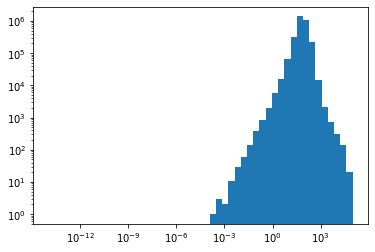

In [24]:
pl.hist(data_rosat5.ravel(), bins=np.logspace(-14, 5), log=True)
pl.loglog();

/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:605: RuntimeWarning: invalid value encountered in bilinear_interpolation_weights
  result = _core.bilinear_interpolation_weights(lon, lat, nside)
/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:570: RuntimeWarning: invalid value encountered in ring_to_nested
  return _core.ring_to_nested(ring_index, nside)


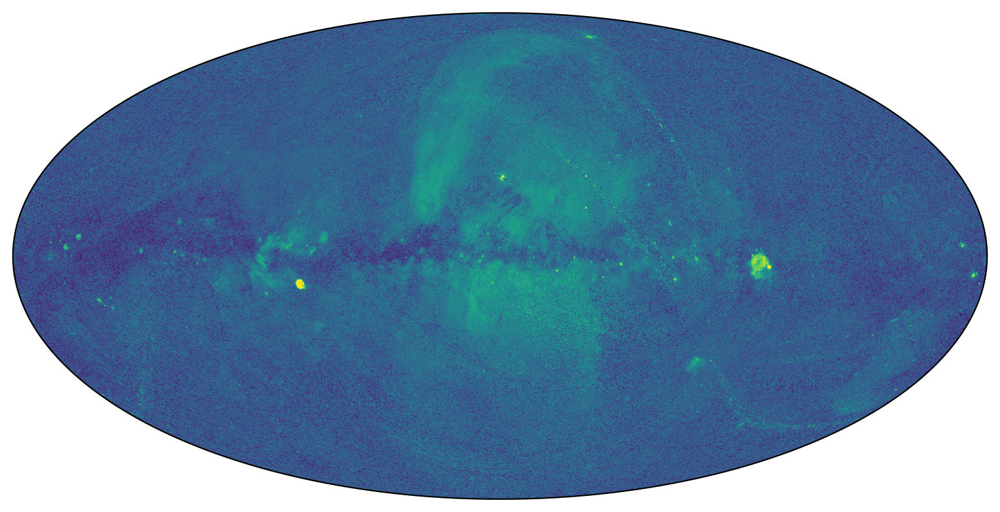

In [25]:
#img_rosat5, footprint = reproject_from_healpix(fn_rosat5, target_header)
data_rosat5 = rosat5[1].data['COUNT_RATE']
data_rosat5 = fix_rosat_nans(np.where(data_rosat5<=1e-8, np.nan, data_rosat5))
img_rosat5, footprint = reproject_from_healpix((data_rosat5.ravel(),
                                                rosat5[1].header["COORDSYS"]),
                                               target_header,
                                               nested=rosat5[1].header["ORDERING"].lower() == "nested"
                                              )
img_rosat5 = fix_nans(np.where(img_rosat5<=1e-9, np.nan, img_rosat5))
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header),
                 frame_class=EllipticalFrame,
                )
ax.imshow(img_rosat5, norm=simple_norm(img_rosat5, min_percent=1, max_percent=99.99, stretch='log'))
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

In [26]:
fn_halpha = "Halpha_map.fits"
if not os.path.exists(fn_halpha):
    halpha = download_file(f"https://lambda.gsfc.nasa.gov/data/foregrounds/fink_halpha/{fn_halpha}")
    shutil.move(halpha, fn_halpha)
halpha = fits.open(fn_halpha)

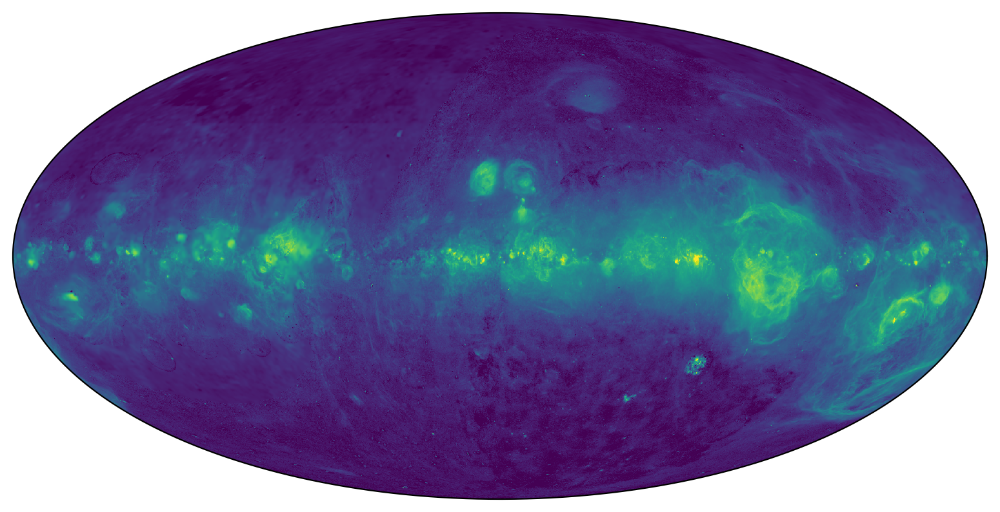

In [27]:
# img_halpha = halpha[0].data
# header = halpha[0].header
img_halpha, footprint = reproject.reproject_interp(fn_halpha, target_header)
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header),
                 frame_class=EllipticalFrame,
                )
ax.imshow(img_halpha, norm=simple_norm(img_halpha, min_percent=1, max_percent=99.99, stretch='log'))
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

In [28]:
fn_akari65 = "akari_mollweide_65_1_4096.fits"
if not os.path.exists(fn_akari65):
    akari65 = download_file(f"https://lambda.gsfc.nasa.gov/data/foregrounds/akari/images/{fn_akari65}")
    shutil.move(akari65, fn_akari65)
akari65 = fits.open(fn_akari65)

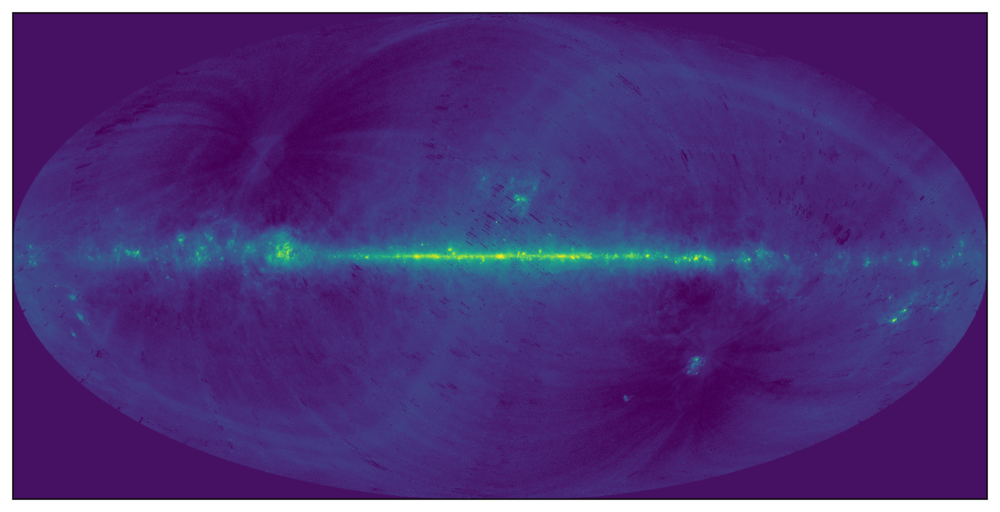

In [29]:
#img_akari65, footprint = reproject_from_healpix(fn_akari65, target_header)
img_akari65 = fix_nans(np.where(akari65[1].data == 0, np.nan, akari65[1].data))
header = akari65[1].header
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(header),
                 #frame_class=EllipticalFrame,
                )
ax.imshow(img_akari65, norm=simple_norm(img_akari65, min_percent=1, max_percent=99.99, stretch='log'))
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

In [30]:
fn_akari90 = "akari_mollweide_WideS_1_4096.fits"
if not os.path.exists(fn_akari90):
    akari90 = download_file(f"https://lambda.gsfc.nasa.gov/data/foregrounds/akari/images/{fn_akari90}")
    shutil.move(akari90, fn_akari90)
akari90 = fits.open(fn_akari90)

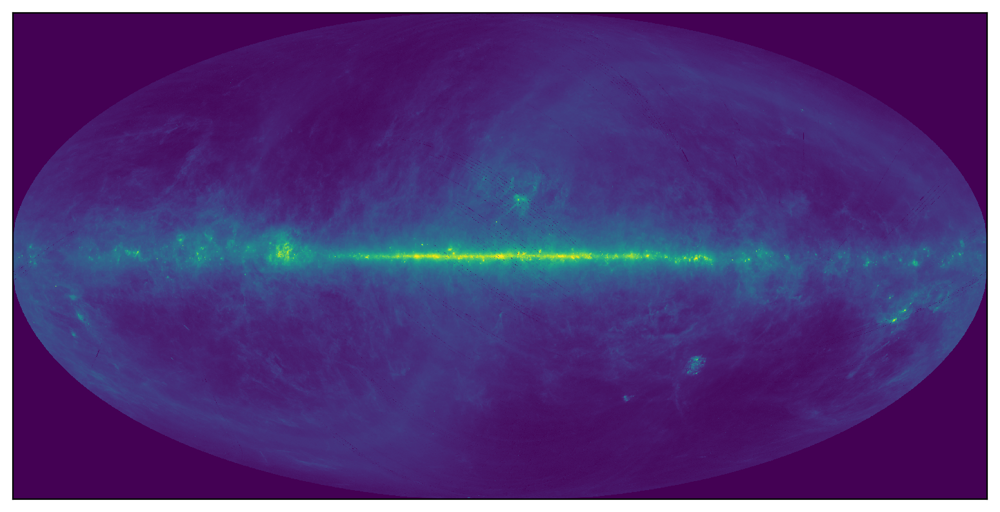

In [31]:
#img_akari90, footprint = reproject_from_healpix(fn_akari90, target_header)
img_akari90 = fix_nans(np.where(akari90[1].data == 0, np.nan, akari90[1].data))
header = akari90[1].header
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(header),
                 #frame_class=EllipticalFrame,
                )
ax.imshow(img_akari90, norm=simple_norm(img_akari90, min_percent=1, max_percent=99.99, stretch='log'))
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

In [32]:
fn_akari140 = "akari_mollweide_WideL_1_4096.fits"
if not os.path.exists(fn_akari140):
    akari140 = download_file(f"https://lambda.gsfc.nasa.gov/data/foregrounds/akari/images/{fn_akari140}")
    shutil.move(akari140, fn_akari140)
akari140 = fits.open(fn_akari140)

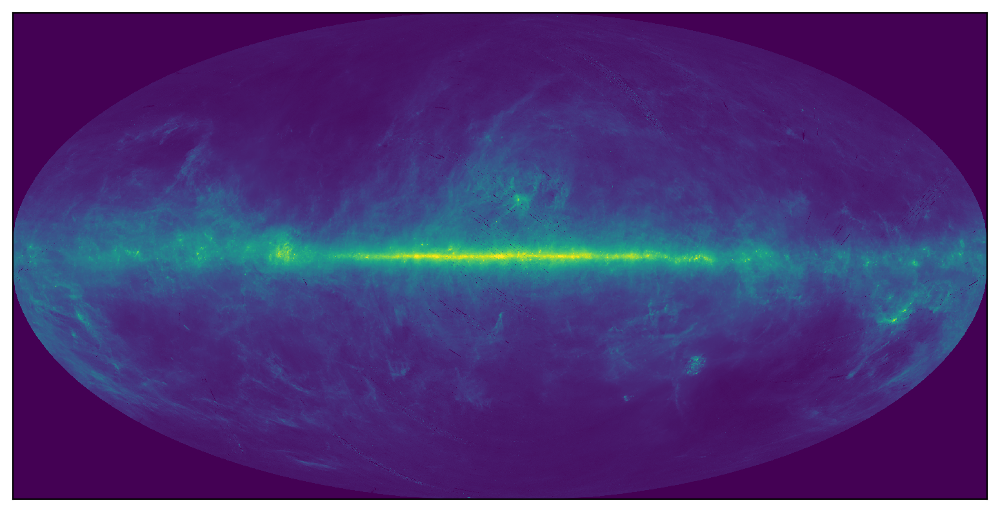

In [33]:
#img_akari140, footprint = reproject_from_healpix(fn_akari140, target_header)
img_akari140 = fix_nans(np.where(akari140[1].data == 0, np.nan, akari140[1].data))
header = akari140[1].header
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(header),
                 #frame_class=EllipticalFrame,
                )
ax.imshow(img_akari140, norm=simple_norm(img_akari140, min_percent=1, max_percent=99.99, stretch='log'))
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

In [34]:
fn_akari160 = "akari_mollweide_160_1_4096.fits"
if not os.path.exists(fn_akari160):
    akari160 = download_file(f"https://lambda.gsfc.nasa.gov/data/foregrounds/akari/images/{fn_akari160}")
    shutil.move(akari160, fn_akari160)
akari160 = fits.open(fn_akari160)

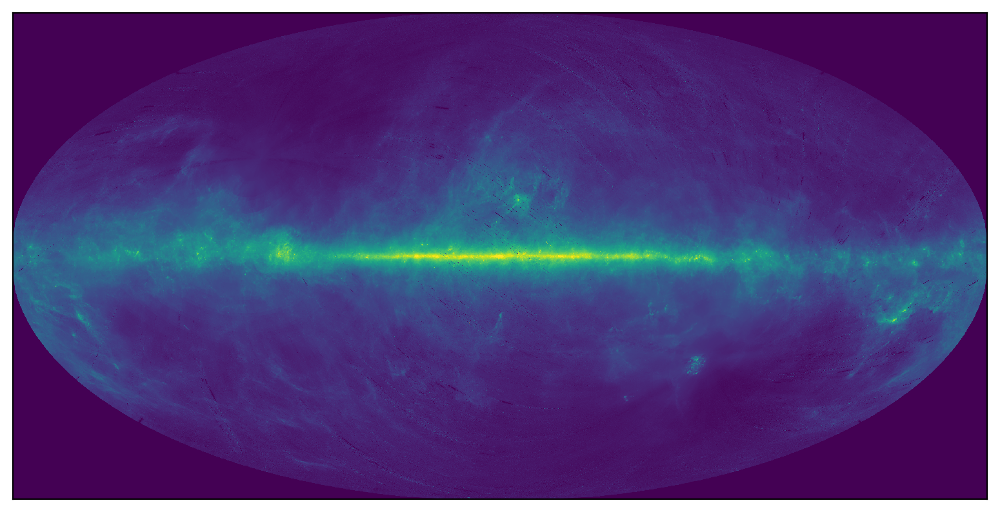

In [35]:
#img_akari160, footprint = reproject_from_healpix(fn_akari160, target_header)
img_akari160 = fix_nans(np.where(akari160[1].data == 0, np.nan, akari160[1].data))
header = akari160[1].header
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(header),
                 #frame_class=EllipticalFrame,
                )
ax.imshow(img_akari160, norm=simple_norm(img_akari160, min_percent=1, max_percent=99.99, stretch='log'))
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

In [36]:
#fn_chipass = "lambda_chipass_HPX_r10.fits"
fn_chipass = "lambda_chipass_mollweide.fits"
if not os.path.exists(fn_chipass):
    chipass = download_file(f"https://lambda.gsfc.nasa.gov/data/foregrounds/chipass/{fn_chipass}")
    shutil.move(chipass, fn_chipass)
chipass = fits.open(fn_chipass)

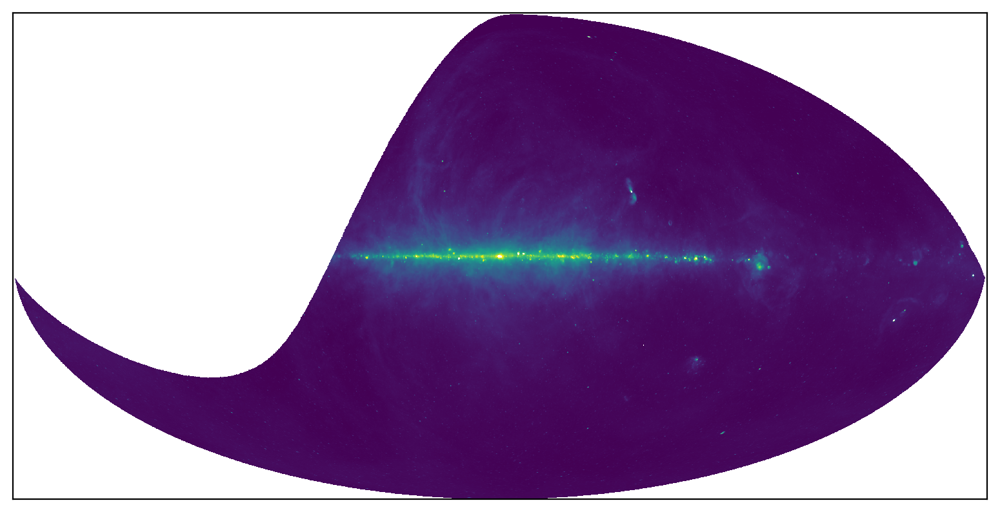

In [37]:
#img_chipass, footprint = reproject_from_healpix(fn_chipass, target_header)
img_chipass = chipass[1].data
img_chipass[img_chipass <= 0] = chipass[2].data[img_chipass <= 0]
img_chipass[img_chipass <= 0] = np.nan
header = chipass[1].header
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(header),
                 #frame_class=EllipticalFrame,
                )
ax.imshow(img_chipass, norm=simple_norm(img_chipass, min_percent=1, max_percent=99.99, stretch='asinh'))
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

In [38]:
fn_sve1420 = "STOCKERT+VILLA-ELISA_1420MHz_1_256.fits"
if not os.path.exists(fn_sve1420):
    sve1420 = download_file(f"https://lambda.gsfc.nasa.gov/data/foregrounds/reich_reich/{fn_sve1420}")
    shutil.move(sve1420, fn_sve1420)
sve1420 = fits.open(fn_sve1420)

/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:605: RuntimeWarning: invalid value encountered in bilinear_interpolation_weights
  result = _core.bilinear_interpolation_weights(lon, lat, nside)
/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:570: RuntimeWarning: invalid value encountered in ring_to_nested
  return _core.ring_to_nested(ring_index, nside)


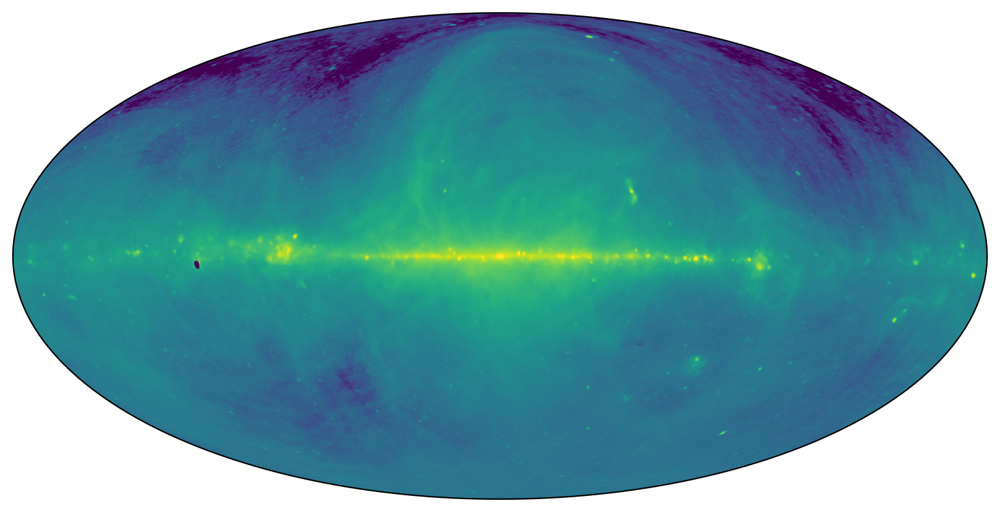

In [39]:
img_sve1420, footprint = reproject_from_healpix(fn_sve1420, target_header)
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header),
                 frame_class=EllipticalFrame)
ax.imshow(img_sve1420, norm=simple_norm(img_sve1420, min_percent=1, max_percent=99.99, stretch='log'))
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

# Planck All-Sky

In [40]:
fn_lfi30 = 'LFI_SkyMap_030_1024_R2.01_full.fits'
if not os.path.exists(fn_lfi30):
    lfi30 = download_file(f"https://irsa.ipac.caltech.edu/data/Planck/release_2/all-sky-maps/maps/{fn_lfi30}")
    shutil.move(lfi30, fn_lfi30)
lfi30 = fits.open(fn_lfi30)

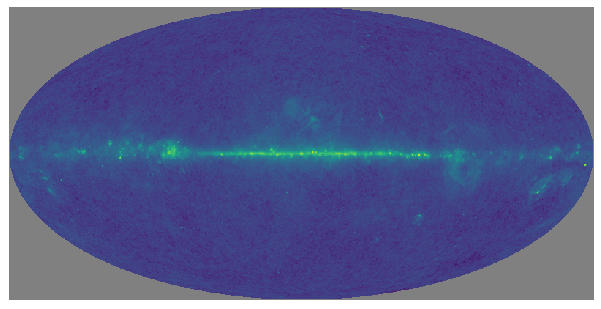

In [41]:
# don't use this any more
m30 = healpy.read_map(lfi30)
healpy.mollview(m30, norm=simple_norm(m30, stretch='log'), cbar=False, title='')

/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:605: RuntimeWarning: invalid value encountered in bilinear_interpolation_weights
  result = _core.bilinear_interpolation_weights(lon, lat, nside)
/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:570: RuntimeWarning: invalid value encountered in ring_to_nested
  return _core.ring_to_nested(ring_index, nside)


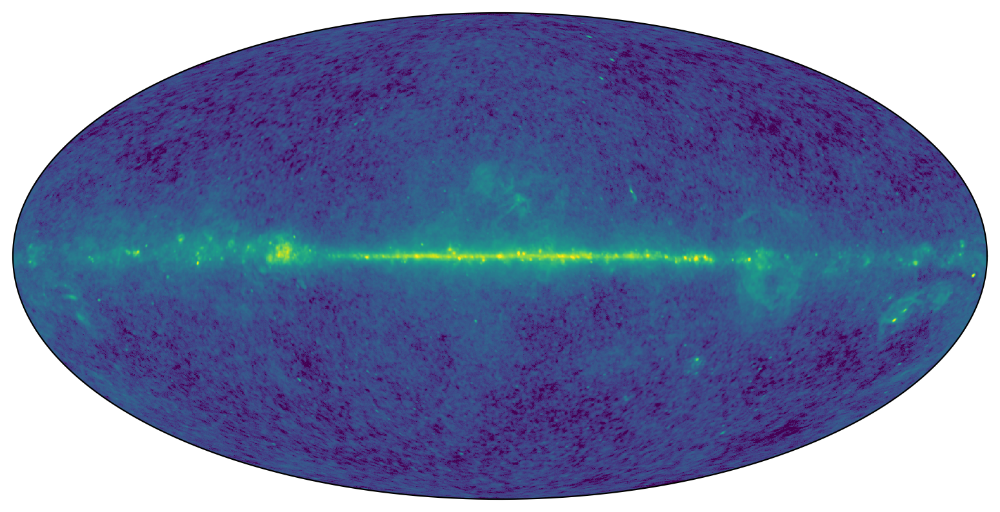

In [42]:
img_lfi30, footprint = reproject_from_healpix(fn_lfi30, target_header)
badinds = np.where(np.isnan(img_lfi30))
img_lfi30 = fix_nans(img_lfi30)
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header),
                 frame_class=EllipticalFrame)
ax.imshow(img_lfi30, norm=simple_norm(img_lfi30, min_percent=1, max_percent=99.99, stretch='log'))
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

In [43]:
fn_hfi143 = "HFI_SkyMap_143_2048_R2.02_full.fits"
if not os.path.exists(fn_hfi143):
    hfi143 = download_file(f"https://irsa.ipac.caltech.edu/data/Planck/release_2/all-sky-maps/maps/{fn_hfi143}")
    shutil.move(hfi143, fn_hfi143)
hfi143 = fits.open(fn_hfi143)

/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:605: RuntimeWarning: invalid value encountered in bilinear_interpolation_weights
  result = _core.bilinear_interpolation_weights(lon, lat, nside)
/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:570: RuntimeWarning: invalid value encountered in ring_to_nested
  return _core.ring_to_nested(ring_index, nside)


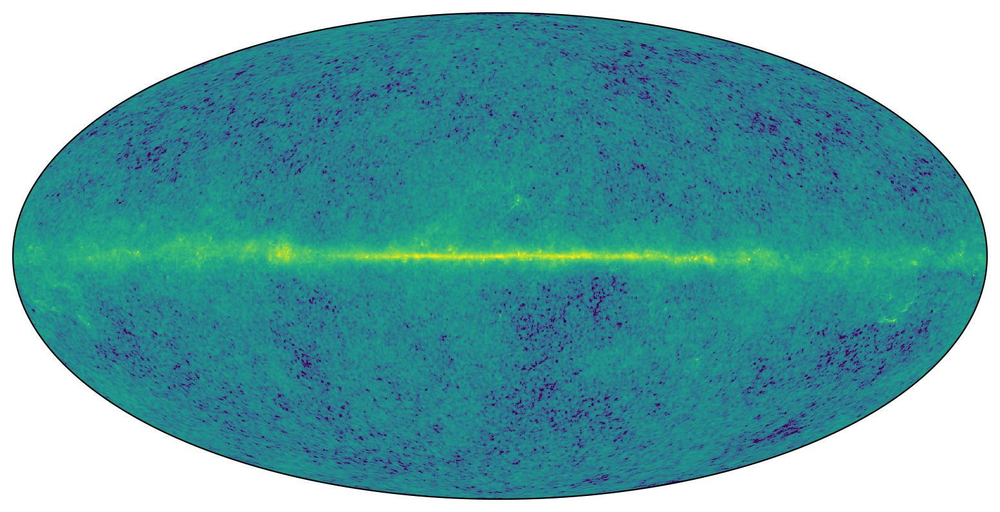

In [44]:
img_hfi143, footprint = reproject_from_healpix(fn_hfi143, target_header)
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header),
                 frame_class=EllipticalFrame)
ax.imshow(img_hfi143, norm=simple_norm(img_hfi143, min_percent=1, max_percent=99.99, stretch='log'))
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

In [45]:
fn_hfi857 = "HFI_SkyMap_857_2048_R2.02_full.fits"
if not os.path.exists(fn_hfi857):
    hfi857 = download_file(f"https://irsa.ipac.caltech.edu/data/Planck/release_2/all-sky-maps/maps/{fn_hfi857}")
    shutil.move(hfi857, fn_hfi857)
hfi857 = fits.open(fn_hfi857)

/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:605: RuntimeWarning: invalid value encountered in bilinear_interpolation_weights
  result = _core.bilinear_interpolation_weights(lon, lat, nside)
/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:570: RuntimeWarning: invalid value encountered in ring_to_nested
  return _core.ring_to_nested(ring_index, nside)


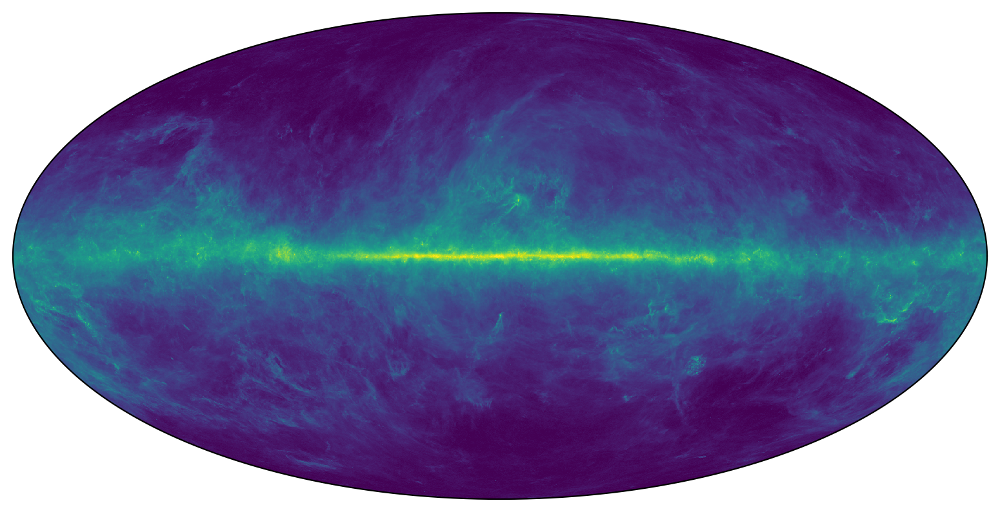

In [46]:
img_hfi857, footprint = reproject_from_healpix(fn_hfi857, target_header)
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header),
                 frame_class=EllipticalFrame)
ax.imshow(img_hfi857, norm=simple_norm(img_hfi857, min_percent=1, max_percent=99.99, stretch='log'))
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


<WCSAxesSubplot:>

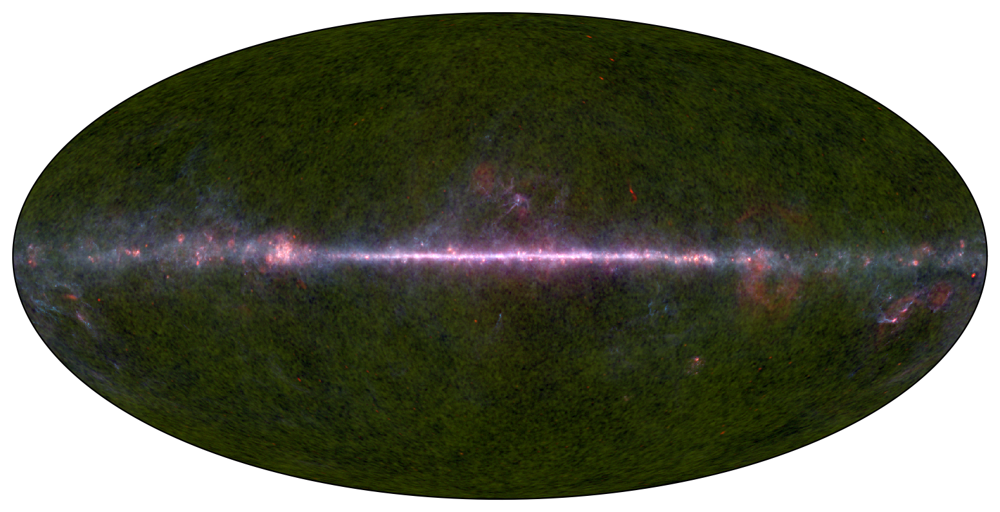

In [47]:
rgb = np.array([simple_norm(img_lfi30,  min_percent=0.01, max_percent=99.90, log_a=5e1, stretch='log')(img_lfi30),
                simple_norm(img_hfi143, min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_hfi143),
                simple_norm(img_hfi857, min_percent=0.01, max_percent=99.90, log_a=5e1, stretch='log')(img_hfi857)]).T.swapaxes(0,1)

make_rgb(rgb, 'Planck_RGB_30-143-857')

In [48]:
fn_synchrotron = "COM_CompMap_Synchrotron-commander_0256_R2.00.fits"
if not os.path.exists(fn_synchrotron):
    planck_synchrotron = download_file(f"https://irsa.ipac.caltech.edu/data/Planck/release_2/all-sky-maps/maps/component-maps/foregrounds/{fn_synchrotron}")
    shutil.move(planck_synchrotron, fn_synchrotron)
planck_synchrotron = fits.open(fn_synchrotron)

/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:605: RuntimeWarning: invalid value encountered in bilinear_interpolation_weights
  result = _core.bilinear_interpolation_weights(lon, lat, nside)
/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:570: RuntimeWarning: invalid value encountered in ring_to_nested
  return _core.ring_to_nested(ring_index, nside)


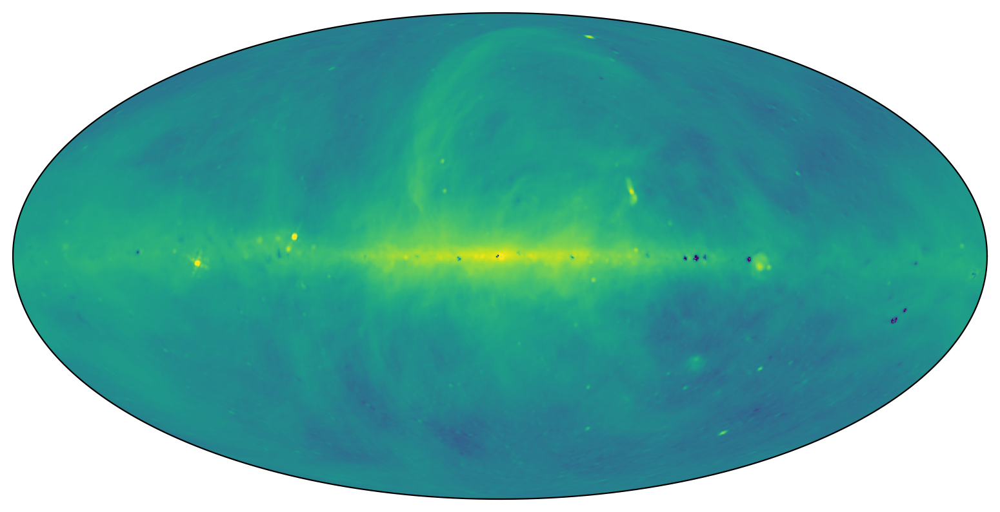

In [49]:
img_synchrotron, footprint = reproject_from_healpix(fn_synchrotron, target_header)
img_synchrotron = fix_nans(np.where(img_synchrotron<=0, np.nan, img_synchrotron))
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header),
                 frame_class=EllipticalFrame)
ax.imshow(img_synchrotron, norm=simple_norm(img_synchrotron, min_percent=1, max_percent=99.99, stretch='log'))
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

In [50]:
fn_freefree = "COM_CompMap_freefree-commander_0256_R2.00.fits"
if not os.path.exists(fn_freefree):
    planck_freefree = download_file(f"https://irsa.ipac.caltech.edu/data/Planck/release_2/all-sky-maps/maps/component-maps/foregrounds/{fn_freefree}")
    shutil.move(planck_freefree, fn_freefree)
planck_freefree = fits.open(fn_freefree)

/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:605: RuntimeWarning: invalid value encountered in bilinear_interpolation_weights
  result = _core.bilinear_interpolation_weights(lon, lat, nside)
/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:570: RuntimeWarning: invalid value encountered in ring_to_nested
  return _core.ring_to_nested(ring_index, nside)


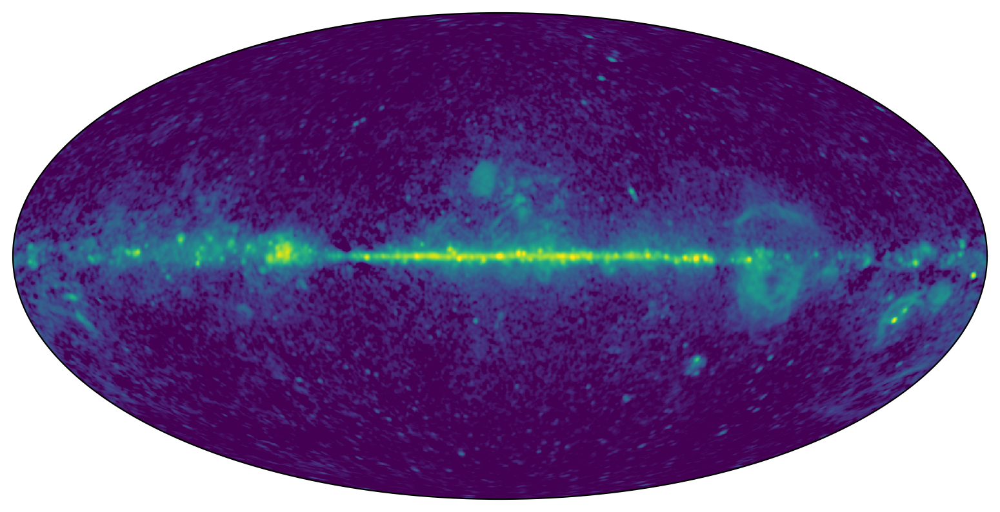

In [51]:
img_freefree, footprint = reproject_from_healpix(fn_freefree, target_header)
img_freefree = fix_nans(img_freefree)
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header),
                 frame_class=EllipticalFrame)
ax.imshow(img_freefree, norm=simple_norm(img_freefree, min_percent=1, max_percent=99.99, stretch='log'))
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

In [52]:
fn_CO21 = "COM_CompMap_CO21-commander_2048_R2.00.fits"
if not os.path.exists(fn_CO21):
    planck_CO21 = download_file(f"https://irsa.ipac.caltech.edu/data/Planck/release_2/all-sky-maps/maps/component-maps/foregrounds/{fn_CO21}")
    shutil.move(planck_CO21, fn_CO21)
planck_CO21 = fits.open(fn_CO21)

In [53]:
img_CO21, footprint = reproject_from_healpix(fn_CO21, target_header)
img_CO21 = fix_nans(img_CO21)
img_CO21_orion, footprint = reproject_from_healpix(fn_CO21, target_header_orion)
img_CO21_orion = fix_nans(img_CO21_orion)

/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:605: RuntimeWarning: invalid value encountered in bilinear_interpolation_weights
  result = _core.bilinear_interpolation_weights(lon, lat, nside)
/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:570: RuntimeWarning: invalid value encountered in ring_to_nested
  return _core.ring_to_nested(ring_index, nside)


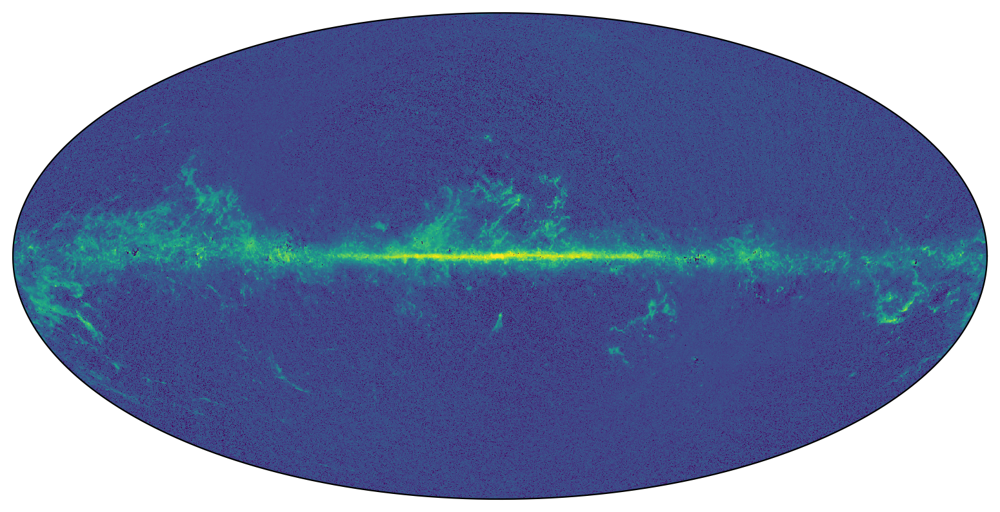

In [54]:
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header),
                 frame_class=EllipticalFrame)
ax.imshow(img_CO21, norm=simple_norm(img_CO21, min_percent=1, max_percent=99.99, stretch='log'))
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

In [55]:
fn_ThermalDust = "COM_CompMap_ThermalDust-commander_2048_R2.00.fits"
if not os.path.exists(fn_ThermalDust):
    planck_ThermalDust = download_file(f"https://irsa.ipac.caltech.edu/data/Planck/release_2/all-sky-maps/maps/component-maps/foregrounds/{fn_ThermalDust}")
    shutil.move(planck_ThermalDust, fn_ThermalDust)
planck_ThermalDust = fits.open(fn_ThermalDust)

In [56]:
img_ThermalDust, footprint = reproject_from_healpix(fn_ThermalDust, target_header)
img_ThermalDust_orion, footprint = reproject_from_healpix(fn_ThermalDust, target_header_orion)

/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:605: RuntimeWarning: invalid value encountered in bilinear_interpolation_weights
  result = _core.bilinear_interpolation_weights(lon, lat, nside)
/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:570: RuntimeWarning: invalid value encountered in ring_to_nested
  return _core.ring_to_nested(ring_index, nside)


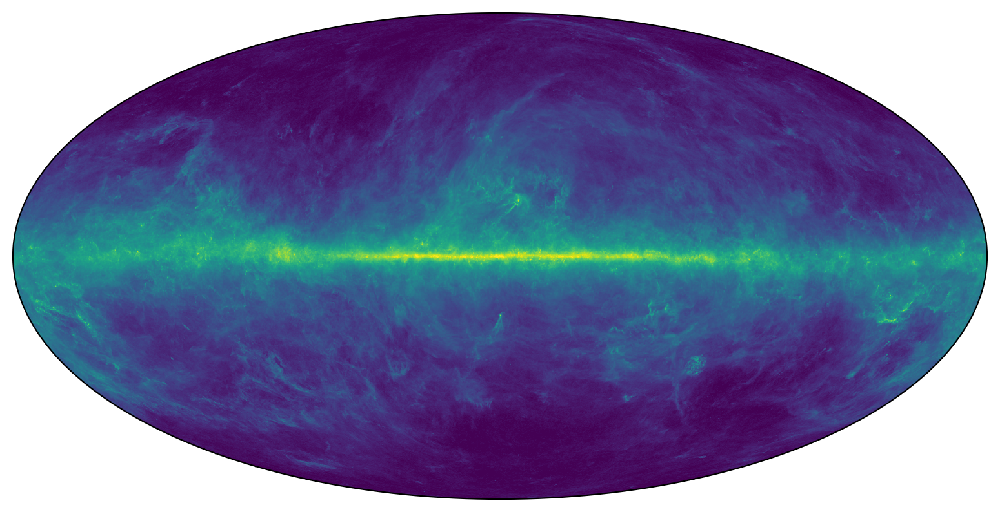

In [57]:
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header),
                 frame_class=EllipticalFrame)
ax.imshow(img_ThermalDust, norm=simple_norm(img_ThermalDust, min_percent=1, max_percent=99.99, stretch='log'))
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

In [58]:
fn_LAB_HI = 'LAB_fullvel.fits'
if not os.path.exists(fn_LAB_HI):
    LAB_HI = download_file(f"https://lambda.gsfc.nasa.gov/data/foregrounds/HI/{fn_LAB_HI}")
    shutil.move(LAB_HI, fn_LAB_HI)
LAB_HI = fits.open(fn_LAB_HI)

In [59]:
fn_HI4PI = 'NHI_HPX.fits'
if not os.path.exists(fn_HI4PI):
    HI4PI = download_file(f"https://lambda.gsfc.nasa.gov/data/foregrounds/HI4PI/{fn_HI4PI}")
    shutil.move(HI4PI, fn_HI4PI)
HI4PI = fits.open(fn_HI4PI)

In [60]:
img_HI4PI, footprint = reproject_from_healpix(fn_HI4PI, target_header, field=5)
img_HI4PI_orion, footprint = reproject_from_healpix(fn_HI4PI, target_header_orion, field=5)

/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:605: RuntimeWarning: invalid value encountered in bilinear_interpolation_weights
  result = _core.bilinear_interpolation_weights(lon, lat, nside)


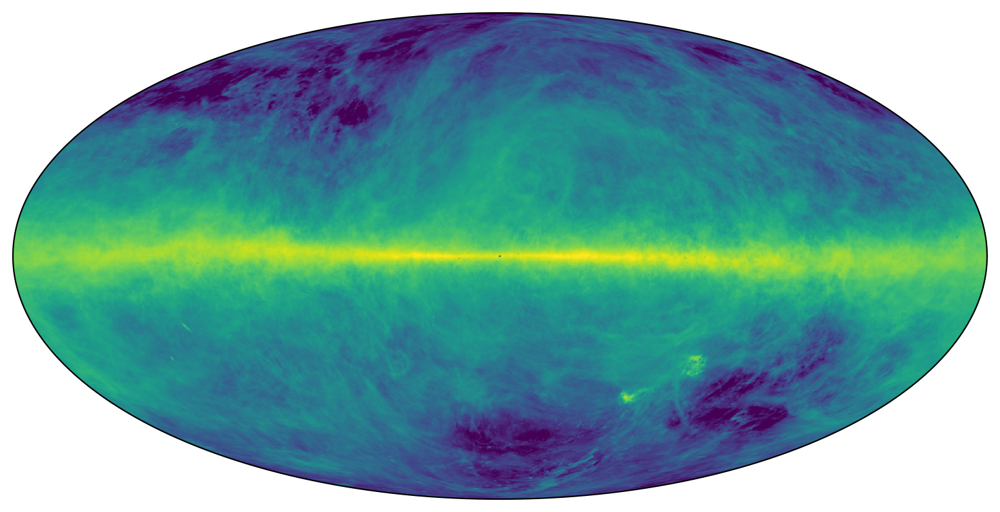

In [61]:
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header),
                 frame_class=EllipticalFrame)
ax.imshow(img_HI4PI, norm=simple_norm(img_HI4PI, min_percent=1, max_percent=99.99, stretch='log'))
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy_healpix/core.py:605: RuntimeWarning: invalid value encountered in bilinear_interpolation_weights
  result = _core.bilinear_interpolation_weights(lon, lat, nside)


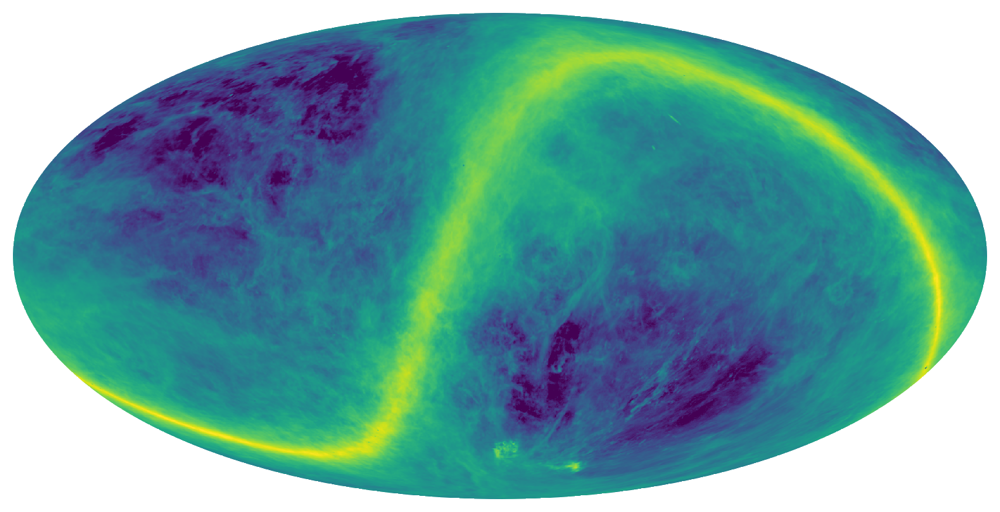

In [62]:
img_HI4PI_orion, footprint = reproject_from_healpix(fn_HI4PI,
                                                    target_header_orion,
                                                    field=5)
plt.figure(figsize=(10,5), dpi=200, frameon=False)
ax = plt.subplot(1,1,1, projection=WCS(target_header_orion),
                 frame_class=EllipticalFrame)
ax.axis('off')
ax.imshow(img_HI4PI_orion,
          norm=simple_norm(img_HI4PI_orion,
                           min_percent=1,
                           max_percent=99.99,
                           stretch='log'))
#ax.coords.grid(color='white')
ax.coords['ra'].set_ticklabel(visible=False)
ax.coords['dec'].set_ticklabel(visible=False)
ax.coords['ra'].set_ticks_visible(False)
ax.coords['dec'].set_ticks_visible(False)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


<WCSAxesSubplot:>

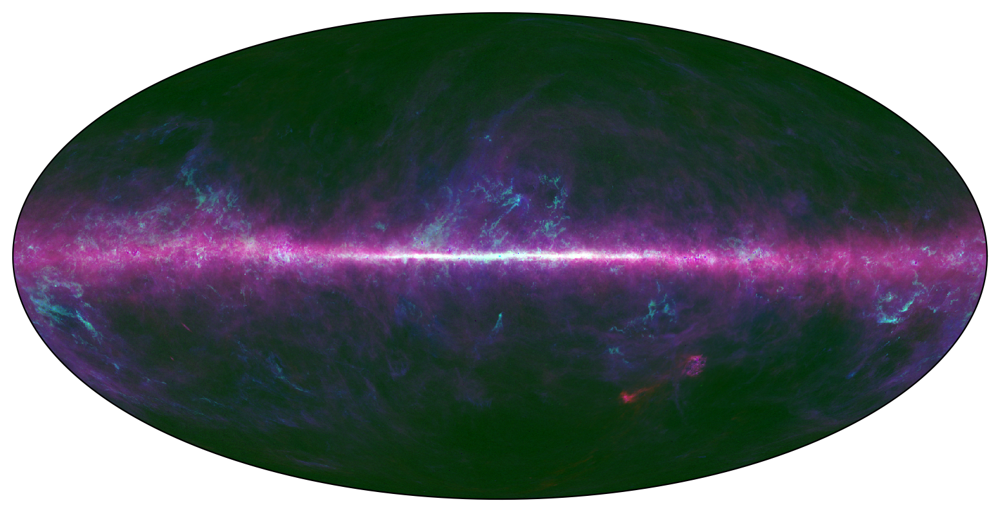

In [63]:
rgb = np.array([simple_norm(img_HI4PI,       min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_HI4PI),
                simple_norm(img_CO21,        min_percent=0.01, max_percent=99.90, log_a=2e1, stretch='log')(img_CO21),
                simple_norm(img_ThermalDust, min_percent=0.01, max_percent=99.90, log_a=5e2, stretch='log')(img_ThermalDust)]).T.swapaxes(0,1)
make_rgb(rgb, 'HI-CO-Dust')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


<WCSAxesSubplot:>

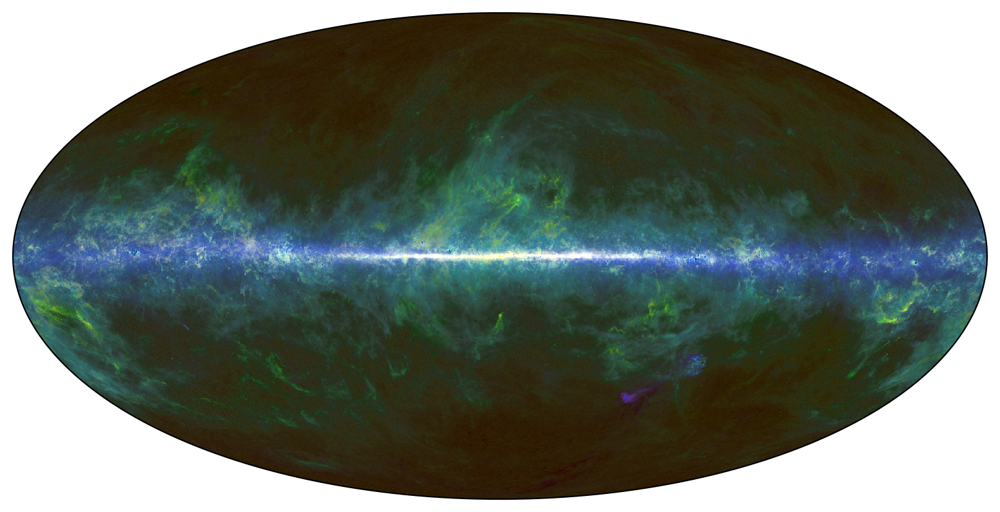

In [64]:
rgb = np.array([simple_norm(img_HI4PI,       min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_HI4PI),
                simple_norm(img_CO21,        min_percent=0.01, max_percent=99.90, log_a=2e1, stretch='log')(img_CO21),
                simple_norm(img_ThermalDust, min_percent=0.01, max_percent=99.90, log_a=5e2, stretch='log')(img_ThermalDust)]).T.swapaxes(0,1)
make_rgb(rgb, 'HI-CO-Dust_m0.25', -0.25, layernames=('HI', 'CO', 'Dust'))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


<WCSAxesSubplot:>

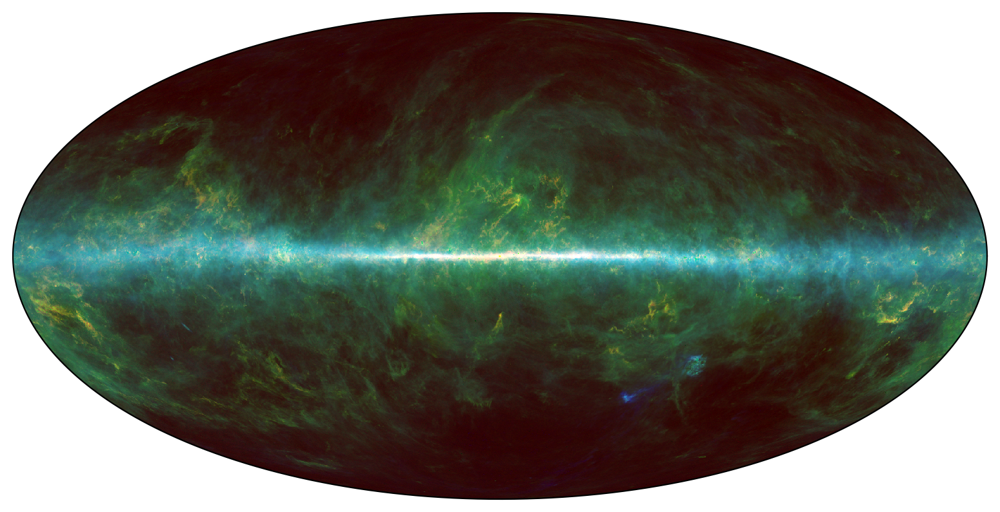

In [65]:
# different colors, overwrites previous
rgb = np.array([simple_norm(img_HI4PI,       min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_HI4PI),
                simple_norm(img_CO21,        min_percent=0.01, max_percent=99.90, log_a=2e1, stretch='log')(img_CO21),
                simple_norm(img_ThermalDust, min_percent=0.01, max_percent=99.90, log_a=5e2, stretch='log')(img_ThermalDust)]).T.swapaxes(0,1)
make_rgb(rgb, 'HI-CO-Dust_m0.35', -0.35, layernames=('HI', 'CO', 'Dust'))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


<WCSAxesSubplot:xlabel='pos.galactic.lon', ylabel='pos.galactic.lat'>

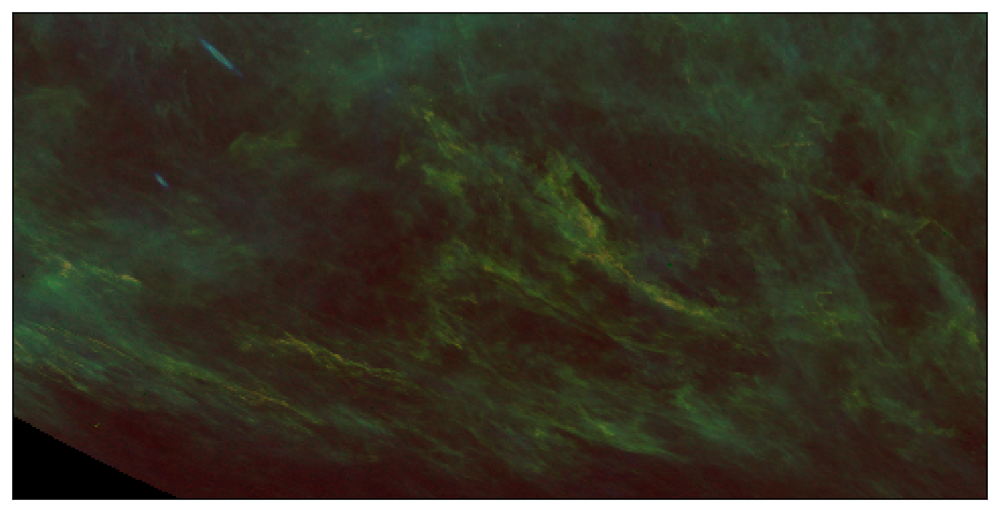

In [66]:
# zoom on lower-left corner
rgb = np.array([simple_norm(img_HI4PI,       min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_HI4PI),
                simple_norm(img_CO21,        min_percent=0.01, max_percent=99.90, log_a=2e1, stretch='log')(img_CO21),
                simple_norm(img_ThermalDust, min_percent=0.01, max_percent=99.90, log_a=5e2, stretch='log')(img_ThermalDust)]).T.swapaxes(0,1)
make_rgb(rgb, 'HI-CO-Dust_m0.35_zoom', -0.35, layernames=('HI', 'CO', 'Dust'),
         axlims=(240, 720, 120, 360), frame_class=None)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


<WCSAxesSubplot:xlabel='pos.galactic.lon', ylabel='pos.galactic.lat'>

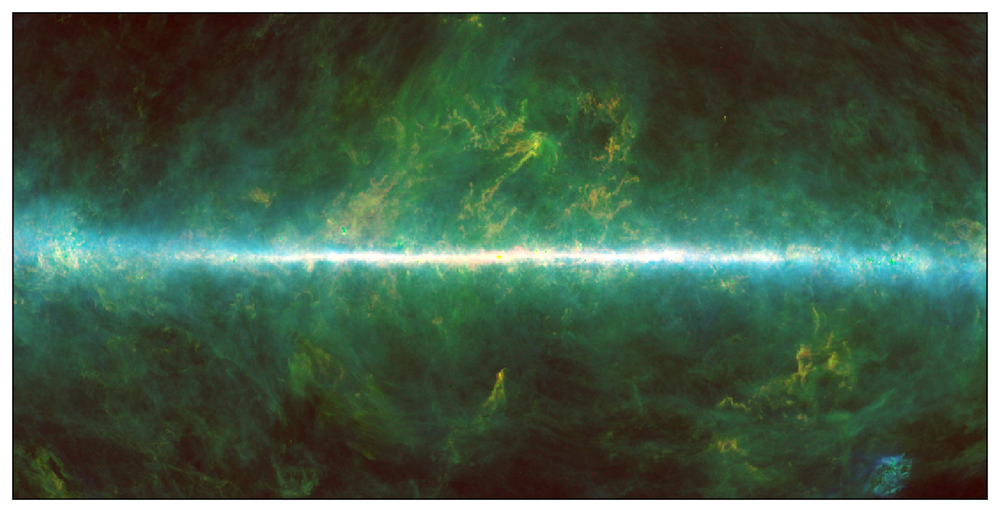

In [67]:
# CMZoom
rgb = np.array([simple_norm(img_HI4PI,       min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_HI4PI),
                simple_norm(img_CO21,        min_percent=0.01, max_percent=99.90, log_a=2e1, stretch='log')(img_CO21),
                simple_norm(img_ThermalDust, min_percent=0.01, max_percent=99.90, log_a=5e2, stretch='log')(img_ThermalDust)]).T.swapaxes(0,1)
make_rgb(rgb, 'HI-CO-Dust_m0.35_zoomCMZ', -0.35, layernames=('HI', 'CO', 'Dust'),
         axlims=(240*2, 720*2, 120*2, 360*2), frame_class=None)

In [68]:
img_rosat5.shape, img_halpha.shape, img_synchrotron.shape

((960, 1920), (960, 1920), (960, 1920))

In [ ]:
rgb = np.array([simple_norm(img_rosat5,  min_percent=0.01, max_percent=99.99, log_a=5e1, stretch='log')(img_rosat5),
                simple_norm(img_halpha, min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_halpha),
                simple_norm(img_synchrotron, min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_synchrotron)]).T.swapaxes(0,1)

make_rgb(rgb, 'XRay_Halpha_Synchro', layernames=('X-Ray', 'Halpha', 'Synchrotron'))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


In [ ]:
rgb = np.array([simple_norm(img_rosat5,  min_percent=0.01, max_percent=99.99, log_a=5e1, stretch='log')(img_rosat5),
                simple_norm(img_synchrotron, min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_synchrotron),
                simple_norm(img_HI4PI, min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_HI4PI),]
              ).T.swapaxes(0,1)

make_rgb(rgb, 'XRay_Synchro_HI4PI', layernames=('X-Ray', 'Synchrotron', 'HI4PI', ), hsv_rotation=-0.25)

In [ ]:
rgb = np.array([simple_norm(img_rosat5,  min_percent=0.01, max_percent=99.99, log_a=5e1, stretch='log')(img_rosat5),
                simple_norm(img_halpha, min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_halpha),
                simple_norm(img_ThermalDust, min_percent=0.01, max_percent=99.99, log_a=5e1, stretch='log')(img_ThermalDust)]).T.swapaxes(0,1)

make_rgb(rgb, 'XRay_Halpha_ThermalDust', layernames=('X-Ray', 'Halpha', 'ThermalDust'))

In [ ]:
rgb = np.array([simple_norm(img_rosat5,  min_percent=0.01, max_percent=99.99, log_a=5e1, stretch='log')(img_rosat5),
                simple_norm(img_halpha, min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_halpha),
                simple_norm(img_CO21, min_percent=0.01, max_percent=99.99, log_a=5e1, stretch='log')(img_CO21)]).T.swapaxes(0,1)

make_rgb(rgb, 'XRay_Halpha_CO21', layernames=('X-Ray', 'Halpha', 'CO21'))

In [ ]:
rgb = np.array([simple_norm(img_rosat5,  min_percent=0.01, max_percent=99.99, log_a=1e3, stretch='log')(img_rosat5),
                simple_norm(img_halpha, min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_halpha),
                simple_norm(img_CO21, min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_CO21)]).T.swapaxes(0,1)

make_rgb(rgb, 'XRay_Halpha_CO21', layernames=('X-Ray', 'Halpha', 'CO21'), hsv_rotation=-0.25)

In [ ]:
xray_synchro = (simple_norm(img_rosat5,  min_percent=0.001, max_percent=99.999, stretch='linear')(img_rosat5) +
                simple_norm(img_synchrotron,  min_percent=0.001, max_percent=99.999, stretch='linear')(img_synchrotron))
rgb = np.array([simple_norm(xray_synchro,  min_percent=0.01, max_percent=99.99, log_a=1e2, stretch='log')(xray_synchro),
                simple_norm(img_halpha, min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_halpha),
                simple_norm(img_CO21, min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_CO21)]).T.swapaxes(0,1)

make_rgb(rgb, 'XRaySynchro_Halpha_CO21', layernames=('X-RaySynchro', 'Halpha', 'CO21'), hsv_rotation=-0.25)

In [ ]:
rgb = np.array([simple_norm(img_rosat5,  min_percent=0.01, max_percent=99.99, log_a=2e2, stretch='log')(img_rosat5),
                simple_norm(img_halpha, min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_halpha),
                simple_norm(img_HI4PI, min_percent=0.01, max_percent=99.99, log_a=2e2, stretch='log')(img_HI4PI)]).T.swapaxes(0,1)

make_rgb(rgb, 'XRay_Halpha_HI4PI', layernames=('X-Ray', 'Halpha', 'HI4PI'))

In [ ]:
rgb = np.array([simple_norm(img_rosat5,  min_percent=0.01, max_percent=99.99, log_a=1e2, stretch='log')(img_rosat5),
                simple_norm(img_halpha, min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_halpha),
                simple_norm(img_freefree, min_percent=0.01, max_percent=99.99, log_a=1e3, stretch='log')(img_freefree)]).T.swapaxes(0,1)

make_rgb(rgb, 'XRay_Halpha_freefree', layernames=('X-Ray', 'Halpha', 'freefree'))

In [ ]:
rgb = np.array([simple_norm(img_rosat5,  min_percent=0.01, max_percent=99.99, log_a=5e2, stretch='log')(img_rosat5),
                simple_norm(img_halpha, min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_halpha),
                simple_norm(img_freefree, min_percent=0.01, max_percent=99.99, log_a=1e2, stretch='log')(img_freefree)]).T.swapaxes(0,1)

make_rgb(rgb, 'XRay_Halpha_freefree', layernames=('X-Ray', 'Halpha', 'freefree'), hsv_rotation=-0.25)

In [ ]:
target_header

In [ ]:
def h_rot(rgb, rot):
    hsv = rgb_to_hsv(rgb)
    hsv[:,:,0] += rot  # 0.25 = 90/360
    hsv[:,:,0] = hsv[:,:,0] % 1 
    rgb_scaled = hsv_to_rgb(hsv)
    return rgb_scaled

def make_rgb(rgb, basename, hsv_rotation=0, layernames='RGB',
             do_layers=True,
             header=target_header,
             axlims=None, frame_class=EllipticalFrame):
    plt.figure(figsize=(10,5), dpi=200)
    ax = plt.subplot(1,1,1, projection=WCS(header),
                     frame_class=frame_class)
    #ax.coords.grid(color='white')
    try:
        ax.coords['glat'].set_ticklabel(visible=False)
        ax.coords['glon'].set_ticklabel(visible=False)
        ax.coords['glat'].set_ticks_visible(False)
        ax.coords['glon'].set_ticks_visible(False)
    except Exception:
        ax.coords['ra'].set_ticklabel(visible=False)
        ax.coords['dec'].set_ticklabel(visible=False)
        ax.coords['ra'].set_ticks_visible(False)
        ax.coords['dec'].set_ticks_visible(False)
    if do_layers:
        for ind, color in zip((0, 1, 2), (layernames)):
            rgbc = np.zeros_like(rgb)
            rgbc[:, :, ind] = rgb[:, :, ind]
            if hsv_rotation != 0:
                rgbc = h_rot(rgbc, hsv_rotation)
            ax.imshow(rgbc)
            pl.savefig(f'{basename}_{color}.png', bbox_inches='tight', transparent=True)
    if hsv_rotation != 0:
        rgb = h_rot(rgb, hsv_rotation)
    ax.imshow(rgb)
    if axlims is not None:
        ax.axis(axlims)
    pl.savefig(f'{basename}_RGB.png', bbox_inches='tight', transparent=True)
    return ax

# CMZ Zoom-In

In [ ]:
target_header_cmz = fits.Header.fromstring("""
NAXIS   =                    2
NAXIS1  =                 1920
NAXIS2  =                  960
CTYPE1  = 'GLON-MOL'
CRPIX1  =                960.5
CRVAL1  =                  0.0
CDELT1  =                -0.05
CUNIT1  = 'deg     '
CTYPE2  = 'GLAT-MOL'
CRPIX2  =                480.5
CRVAL2  =                  0.0
CDELT2  =                 0.05
CUNIT2  = 'deg     '
COORDSYS= 'icrs    '
""", sep='\n')

In [ ]:
target_header_innergal = fits.Header.fromstring("""
NAXIS   =                    2
NAXIS1  =                 3840
NAXIS2  =                  960
CTYPE1  = 'GLON-MOL'
CRPIX1  =               1920.5
CRVAL1  =                  0.0
CDELT1  =                -0.05
CUNIT1  = 'deg     '
CTYPE2  = 'GLAT-MOL'
CRPIX2  =                480.5
CRVAL2  =                  0.0
CDELT2  =                 0.05
CUNIT2  = 'deg     '
COORDSYS= 'icrs    '
""", sep='\n')

In [ ]:
img_HI4PI_cmz, footprint = reproject_from_healpix(fn_HI4PI, target_header_cmz, field=5)
img_ThermalDust_cmz, footprint = reproject_from_healpix(fn_ThermalDust, target_header_cmz)
img_CO21_cmz, footprint = reproject_from_healpix(fn_CO21, target_header_cmz)

In [ ]:
img_HI4PI_innergal, footprint = reproject_from_healpix(fn_HI4PI, target_header_innergal, field=5)
img_ThermalDust_innergal, footprint = reproject_from_healpix(fn_ThermalDust, target_header_innergal)
img_CO21_innergal, footprint = reproject_from_healpix(fn_CO21, target_header_innergal)

In [ ]:
rgb = np.array([simple_norm(img_HI4PI_cmz,       min_percent=0.01, max_percent=99.99, log_a=1e1, stretch='log')(img_HI4PI_cmz),
                simple_norm(img_CO21_cmz,        min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_CO21_cmz),
                simple_norm(img_ThermalDust_cmz, min_percent=0.01, max_percent=99.99, log_a=5e2, stretch='log')(img_ThermalDust_cmz)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header_cmz),)
                 #frame_class=EllipticalFrame)
ax.imshow(rgb_scaled)
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)
ax.set_xlim(240*2, 720*2)
ax.set_ylim(120*2, 360*2)

# HI

 * all-sky:  https://lambda.gsfc.nasa.gov/data/foregrounds/HI/LAB_fullvel.fits
 * hi4pi: https://lambda.gsfc.nasa.gov/data/foregrounds/HI4PI/NHI_HPX.fits

In [ ]:
from astropy import units as u

In [ ]:
hi_cube_fn = '/orange/adamginsburg/cmz/hi/mcluregriffiths/GC.hi.tb.allgal.fits'
#if os.path.exists("GC.hi.tb.allgal.fits.gz"):
#    hi_cube_fh = fits.open("GC.hi.tb.allgal.fits.gz")
#else:
#    print("Not downloaded.")
#    #hi_cube_fh = download_file("http://www.atnf.csiro.au/research/HI/sgps/SGPS_1/GC.hi.tb.allgal.fits.gz")
hi_cube = SpectralCube.read(hi_cube_fn, use_dask=True)

In [ ]:
peak_hi = hi_cube.max(axis=0)
mean_hi = hi_cube.mean(axis=0)

In [ ]:
pl.imshow(peak_hi.value)

In [ ]:
pl.imshow(mean_hi.value, vmin=0)

In [ ]:
from matplotlib.colors import ListedColormap
cmap = pl.cm.gray
gray_transparent = cmap(np.arange(cmap.N))
gray_transparent[:,-1] = np.linspace(0, 1, cmap.N)
gray_transparent = ListedColormap(gray_transparent)
cmap = pl.cm.Oranges
orange_transparent = cmap(np.arange(cmap.N))
orange_transparent[:,-1] = np.linspace(0, 1, cmap.N)
orange_transparent = ListedColormap(orange_transparent)

cmap = pl.cm.Oranges_r
orange_transparent_r = cmap(np.arange(cmap.N))
orange_transparent_r[:,-1] = np.linspace(0, 1, cmap.N)
orange_transparent_r = ListedColormap(orange_transparent_r)

orange_transparent2 = cmap(np.arange(cmap.N))
orange_transparent2[:,-1] = np.linspace(0, 1, cmap.N)
orange_transparent2[:,:-1] = [0.95, 0.35, 0.03]
orange_transparent2 = ListedColormap(orange_transparent2)

In [ ]:
if os.path.exists("DHT02_Center_interp.fits"):
    cube_dame12co = SpectralCube.read('DHT02_Center_interp.fits', use_dask=True)
else:
    pass

In [ ]:
peak_dameco = cube_dame12co.max(axis=0)
mean_dameco = cube_dame12co.mean(axis=0)

In [ ]:
if os.path.exists('GalacticCenterMosaic_downsampled4x_2kms.fits'):
    co_cube = SpectralCube.read('GalacticCenterMosaic_downsampled4x_2kms.fits', use_dask=True)
peak_co = co_cube.max(axis=0)
mean_co = co_cube.mean(axis=0)

In [ ]:
rgb = np.array([simple_norm(img_HI4PI_cmz,       min_percent=0.01, max_percent=99.99, log_a=1e1, stretch='log')(img_HI4PI_cmz),
                simple_norm(img_CO21_cmz,        min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_CO21_cmz),
                simple_norm(img_ThermalDust_cmz, min_percent=0.01, max_percent=99.99, log_a=5e2, stretch='log')(img_ThermalDust_cmz)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header_cmz),)
                 #frame_class=EllipticalFrame)
ax.imshow(rgb_scaled)
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)
ax.set_xlim(240*2, 720*2)
ax.set_ylim(120*2, 360*2)

ax.imshow(mean_hi.value,
          transform=ax.get_transform(hi_cube.wcs.celestial),
          norm=simple_norm(mean_hi.value, min_percent=2, max_percent=99.9, stretch='asinh'),
          cmap=orange_transparent)

In [ ]:
rgb = np.array([simple_norm(img_HI4PI_cmz,       min_percent=0.01, max_percent=99.99, log_a=1e1, stretch='log')(img_HI4PI_cmz),
                simple_norm(img_CO21_cmz,        min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_CO21_cmz),
                simple_norm(img_ThermalDust_cmz, min_percent=0.01, max_percent=99.99, log_a=5e2, stretch='log')(img_ThermalDust_cmz)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header_cmz),)
                 #frame_class=EllipticalFrame)
ax.imshow(rgb_scaled)
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)
ax.set_xlim(240*2, 720*2)
ax.set_ylim(120*2, 360*2)

ax.imshow(mean_dameco.value,
          norm=simple_norm(mean_dameco.value, min_percent=2, max_percent=99.9, stretch='asinh'),
          transform=ax.get_transform(cube_dame12co.wcs.celestial),
          cmap=orange_transparent)

pl.savefig("HI4PI_CO_Dust_withDameCOOrangeOverlay.png", bbox_inches='tight')

In [ ]:
rgb = np.array([simple_norm(img_HI4PI_cmz,       min_percent=0.01, max_percent=99.99, log_a=1e1, stretch='log')(img_HI4PI_cmz),
                simple_norm(img_CO21_cmz,        min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_CO21_cmz),
                simple_norm(img_ThermalDust_cmz, min_percent=0.01, max_percent=99.99, log_a=5e2, stretch='log')(img_ThermalDust_cmz)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header_cmz),)
                 #frame_class=EllipticalFrame)
ax.imshow(rgb_scaled)
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)
ax.set_xlim(240*2, 720*2)
ax.set_ylim(120*2, 360*2)

ax.imshow(peak_co.value,
          norm=simple_norm(peak_co.value, min_percent=0.1, max_percent=99.9, stretch='asinh'),
          transform=ax.get_transform(co_cube.wcs.celestial),
          cmap=orange_transparent)

pl.savefig("HI4PI_CO_Dust_withJCMTCOOrange.png", bbox_inches='tight')

In [ ]:
atlasgal = fits.open('/orange/adamginsburg/galactic_plane_surveys/atlasgal/MOSAICS/apex_planck.fits')
print(atlasgal[0].data.shape)

In [ ]:
rgb = np.array([simple_norm(img_HI4PI_cmz,       min_percent=0.01, max_percent=99.99, log_a=1e1, stretch='log')(img_HI4PI_cmz),
                simple_norm(img_CO21_cmz,        min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_CO21_cmz),
                simple_norm(img_ThermalDust_cmz, min_percent=0.01, max_percent=99.99, log_a=5e2, stretch='log')(img_ThermalDust_cmz)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header_cmz),)
                 #frame_class=EllipticalFrame)
ax.imshow(rgb_scaled)
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)
ax.set_xlim(240*2, 720*2)
ax.set_ylim(120*2, 360*2)

ax.imshow(atlasgal[0].data,
          norm=simple_norm(atlasgal[0].data, min_percent=0.1, max_percent=99.9, stretch='asinh'),
          transform=ax.get_transform(WCS(atlasgal[0].header)),
          cmap='gray')

pl.savefig("HI4PI_CO_Dust_withATLASGAL.png", bbox_inches='tight')

In [ ]:
rgb = np.array([simple_norm(img_HI4PI_cmz,       min_percent=0.01, max_percent=99.99, log_a=1e1, stretch='log')(img_HI4PI_cmz),
                simple_norm(img_CO21_cmz,        min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_CO21_cmz),
                simple_norm(img_ThermalDust_cmz, min_percent=0.01, max_percent=99.99, log_a=5e2, stretch='log')(img_ThermalDust_cmz)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header_cmz),)
                 #frame_class=EllipticalFrame)
ax.imshow(rgb_scaled)
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)
ax.set_xlim(240*2, 720*2)
ax.set_ylim(120*2, 360*2)

ax.imshow(atlasgal[0].data,
          norm=simple_norm(atlasgal[0].data, min_percent=5, max_percent=99.9, stretch='asinh'),
          transform=ax.get_transform(WCS(atlasgal[0].header)),
          cmap=gray_transparent)
pl.savefig("HI4PI_CO_Dust_withATLASGALtransparent.png", bbox_inches='tight')

In [ ]:
rgb = np.array([simple_norm(img_HI4PI_cmz,       min_percent=0.01, max_percent=99.99, log_a=1e1, stretch='log')(img_HI4PI_cmz),
                simple_norm(img_CO21_cmz,        min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_CO21_cmz),
                simple_norm(img_ThermalDust_cmz, min_percent=0.01, max_percent=99.99, log_a=5e2, stretch='log')(img_ThermalDust_cmz)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header_cmz),)
                 #frame_class=EllipticalFrame)
ax.imshow(rgb_scaled)
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)
ax.set_xlim(240*2, 720*2)
ax.set_ylim(120*2, 360*2)

ax.imshow(atlasgal[0].data,
          norm=simple_norm(atlasgal[0].data, min_percent=5, max_percent=99.9, stretch='asinh'),
          transform=ax.get_transform(WCS(atlasgal[0].header)),
          cmap=orange_transparent)
pl.savefig("HI4PI_CO_Dust_withATLASGALOrangetransparent.png", bbox_inches='tight')

In [ ]:
from astroquery.vizier import Vizier
from astropy.coordinates import SkyCoord
almaimf_cat = Vizier.get_catalogs('J/A+A/662/A9/objects')[0]
almaimf_crds = SkyCoord(almaimf_cat['RAJ2000'], almaimf_cat['DEJ2000'], frame='fk5', unit=(u.h, u.deg))

In [ ]:
rgb = np.array([simple_norm(img_HI4PI_cmz,       min_percent=0.01, max_percent=99.99, log_a=1e1, stretch='log')(img_HI4PI_cmz),
                simple_norm(img_CO21_cmz,        min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_CO21_cmz),
                simple_norm(img_ThermalDust_cmz, min_percent=0.01, max_percent=99.99, log_a=5e2, stretch='log')(img_ThermalDust_cmz)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header_cmz),)
                 #frame_class=EllipticalFrame)
ax.imshow(rgb_scaled)
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)
ax.set_xlim(240*2, 720*2)
ax.set_ylim(120*2, 360*2)

ax.imshow(atlasgal[0].data,
          norm=simple_norm(atlasgal[0].data, min_percent=5, max_percent=99.9, stretch='asinh'),
          transform=ax.get_transform(WCS(atlasgal[0].header)),
          cmap=orange_transparent)


ax.scatter(almaimf_crds.galactic.l, almaimf_crds.galactic.b,
           marker='*', edgecolor='purple', facecolor='none', transform=ax.get_transform('galactic'))

pl.savefig("HI4PI_CO_Dust_withATLASGALOrangetransparent_ALMA-IMFtargets.png", bbox_inches='tight')

In [ ]:
rgb = np.array([simple_norm(img_HI4PI_innergal,       min_percent=0.01, max_percent=99.99, log_a=1e1, stretch='log')(img_HI4PI_innergal),
                simple_norm(img_CO21_innergal,        min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_CO21_innergal),
                simple_norm(img_ThermalDust_innergal, min_percent=0.01, max_percent=99.99, log_a=5e2, stretch='log')(img_ThermalDust_innergal)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header_innergal),)
                 #frame_class=EllipticalFrame)
ax.imshow(rgb_scaled)
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)
ax.set_xlim(540, 3840-540)
ax.set_ylim(0, 960)

ax.imshow(atlasgal[0].data,
          norm=simple_norm(atlasgal[0].data, min_percent=5, max_percent=99.9, stretch='asinh'),
          transform=ax.get_transform(WCS(atlasgal[0].header)),
          cmap=orange_transparent)

pl.savefig("HI4PI_CO_Dust_innergal_withATLASGALOrangetransparent.png", bbox_inches='tight')

ax.scatter(almaimf_crds.galactic.l, almaimf_crds.galactic.b,
           marker='*', edgecolor='purple', facecolor='none', transform=ax.get_transform('galactic'))

pl.savefig("HI4PI_CO_Dust_innergal_withATLASGALOrangetransparent_ALMA-IMFtargets.png", bbox_inches='tight')


import regions
from astropy import coordinates
rect = regions.RectangleSkyRegion(
    coordinates.SkyCoord(0*u.deg, 0*u.deg, frame='galactic'),
    width=np.abs((ax.get_xlim()[1] - ax.get_xlim()[0])*target_header_innergal['CDELT1'])*u.deg,
    height=(ax.get_ylim()[1] - ax.get_ylim()[0])*target_header_innergal['CDELT2']*u.deg,
)

In [ ]:
# different colors, overwrites previous
rgb = np.array([simple_norm(img_HI4PI,       min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_HI4PI),
                simple_norm(img_CO21,        min_percent=0.01, max_percent=99.90, log_a=2e1, stretch='log')(img_CO21),
                simple_norm(img_ThermalDust, min_percent=0.01, max_percent=99.90, log_a=5e2, stretch='log')(img_ThermalDust)]).T.swapaxes(0,1)
ax = make_rgb(rgb, 'HI-CO-Dust_m0.35', -0.35, layernames=('HI', 'CO', 'Dust'), do_layers=False)
prect = rect.to_pixel(ax.wcs)
prect.visual['edgecolor'] = 'w'
innergalplot = prect.plot(ax=ax)

pl.savefig("HI-CO-Dust_m0.35_RGB_innergal_zoombox.png", bbox_inches='tight')

innergaltext = ax.text(0, 25, "Galactic Plane", transform=ax.get_transform('world'),
        color='w', horizontalalignment='center')

cmzrect = regions.RectangleSkyRegion(
    coordinates.SkyCoord(0*u.deg, 0*u.deg, frame='galactic'),
    width=12*u.deg,
    height=4.8*u.deg,
)
pcmzrect = cmzrect.to_pixel(ax.wcs)
pcmzrect.visual['edgecolor'] = 'w'
cmzplot = pcmzrect.plot(ax=ax)

cmztext = ax.text(0, 5, "Central Molecular Zone", transform=ax.get_transform('world'),
        color='w', horizontalalignment='center')


orionrect = regions.RectangleSkyRegion(
    coordinates.SkyCoord(209*u.deg, -19*u.deg, frame='galactic'),
    width=15*u.deg,
    height=15*u.deg,
)
porionrect = orionrect.to_pixel(ax.wcs)
porionrect.visual['edgecolor'] = 'w'
oriplot = porionrect.plot(ax=ax)
oritext = ax.text(209, -7, "Orion", transform=ax.get_transform('world'),
        color='w', horizontalalignment='center')

pl.savefig("HI-CO-Dust_m0.35_RGB_labeled_zones.png", bbox_inches='tight')

innergalplot.set_visible(False)
cmzplot.set_visible(False)
innergaltext.set_visible(False)
cmztext.set_visible(False)

pl.savefig("HI-CO-Dust_m0.35_RGB_labeled_orion.png", bbox_inches='tight')

oritext.set_visible(False)
oriplot.set_visible(False)

m31 = coordinates.SkyCoord.from_name('M31')
andromedarect = regions.RectangleSkyRegion(
    m31,
    width=5*u.deg,
    height=5*u.deg,
)
pandromedarect = andromedarect.to_pixel(ax.wcs)
pandromedarect.visual['edgecolor'] = 'w'
andromedaplot = pandromedarect.plot(ax=ax)
andromedatext = ax.text(m31.galactic.l.deg, m31.galactic.b.deg+4,
                        "Andromeda", transform=ax.get_transform('world'),
        color='w', horizontalalignment='center')

pl.savefig("HI-CO-Dust_m0.35_RGB_labeled_andromeda.png", bbox_inches='tight')

andromedatext.set_visible(False)
andromedaplot.set_visible(False)


taurus = coordinates.SkyCoord.from_name('taurus')
taurusrect = regions.RectangleSkyRegion(
    taurus,
    width=15*u.deg,
    height=15*u.deg,
)
ptaurusrect = taurusrect.to_pixel(ax.wcs)
ptaurusrect.visual['edgecolor'] = 'w'
taurusplot = ptaurusrect.plot(ax=ax)
taurustext = ax.text(taurus.galactic.l.deg-5, taurus.galactic.b.deg+10,
                        "Taurus", transform=ax.get_transform('world'),
        color='w', horizontalalignment='center')

pl.savefig("HI-CO-Dust_m0.35_RGB_labeled_taurus.png", bbox_inches='tight')

taurustext.set_visible(False)
taurusplot.set_visible(False)

In [ ]:
# different colors, overwrites previous
rgb = np.array([simple_norm(img_HI4PI_orion,      min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_HI4PI_orion),
                simple_norm(img_CO21_orion,        min_percent=0.01, max_percent=99.90, log_a=2e1, stretch='log')(img_CO21_orion),
                simple_norm(img_ThermalDust_orion, min_percent=0.01, max_percent=99.90, log_a=5e2, stretch='log')(img_ThermalDust_orion)]).T.swapaxes(0,1)
ax = make_rgb(rgb, 'HI-CO-Dust_m0.35_orion', -0.35,
              header=target_header_orion,
              layernames=('HI', 'CO', 'Dust'), do_layers=False)

orionrect = regions.RectangleSkyRegion(
    coordinates.SkyCoord(209*u.deg, -19*u.deg, frame='galactic'),
    width=15*u.deg,
    height=15*u.deg,
)
porionrect = orionrect.to_pixel(ax.wcs)
porionrect.visual['edgecolor'] = 'w'
oriplot = porionrect.plot(ax=ax)

oritext = ax.text(83.82, 5, "Orion", transform=ax.get_transform('world'),
        color='w', horizontalalignment='center')

pl.savefig("HI-CO-Dust_m0.35_orion_RGB_labeled_orion.png", bbox_inches='tight')

In [ ]:
target_header_oricloud = fits.Header.fromstring("""
NAXIS   =                    2
NAXIS1  =                 1920
NAXIS2  =                 1920
CTYPE1  = 'RA---TAN'
CRPIX1  =                960.5
CRVAL1  =                83.82
CDELT1  =                -0.05
CUNIT1  = 'deg     '
CTYPE2  = 'DEC--TAN'
CRPIX2  =                960.5
CRVAL2  =                -5.39
CDELT2  =                 0.05
CUNIT2  = 'deg     '
COORDSYS= 'icrs    '
""", sep='\n')

In [ ]:
img_HI4PI_oricloud, footprint = reproject_from_healpix(fn_HI4PI, target_header_oricloud, field=5)
img_ThermalDust_oricloud, footprint = reproject_from_healpix(fn_ThermalDust, target_header_oricloud)
img_CO21_oricloud, footprint = reproject_from_healpix(fn_CO21, target_header_oricloud)

In [ ]:
# different colors, overwrites previous
rgb = np.array([simple_norm(img_HI4PI,       min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_HI4PI_oricloud),
                simple_norm(img_CO21,        min_percent=0.01, max_percent=99.90, log_a=2e1, stretch='log')(img_CO21_oricloud),
                simple_norm(img_ThermalDust, min_percent=0.01, max_percent=99.90, log_a=5e2, stretch='log')(img_ThermalDust_oricloud)]).T.swapaxes(0,1)

hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

plt.figure(figsize=(10,5), dpi=200, frameon=False)
ax = plt.subplot(1,1,1, projection=WCS(target_header_oricloud),)
ax.imshow(rgb_scaled)
ax.axis('off')

oricloudrect = regions.RectangleSkyRegion(
    coordinates.SkyCoord(209*u.deg, -19*u.deg, frame='galactic'),
    width=15*u.deg,
    height=15*u.deg,
)
poricloudrect = oricloudrect.to_pixel(ax.wcs)
poricloudrect.visual['edgecolor'] = 'w'
oriplot = poricloudrect.plot(ax=ax)

oritext = ax.text(80, 4, "Orion", transform=ax.get_transform('world'),
        color='w', horizontalalignment='center')
ax.axis([480,1440,480,1440])
pl.savefig("HI-CO-Dust_m0.35_oricloud_RGB_labeled_oricloud.png",
           bbox_inches='tight',
           pad_inches=0)

In [ ]:
target_header_omc = fits.Header.fromstring("""
NAXIS   =                    2
NAXIS1  =                 1920
NAXIS2  =                 1920
CTYPE1  = 'RA---TAN'
CRPIX1  =                960.5
CRVAL1  =                83.82
CDELT1  =              -0.0005
CUNIT1  = 'deg     '
CTYPE2  = 'DEC--TAN'
CRPIX2  =                960.5
CRVAL2  =                -5.39
CDELT2  =               0.0005
CUNIT2  = 'deg     '
COORDSYS= 'icrs    '
""", sep='\n')

In [ ]:
1920*0.0005

In [ ]:
fn_carmaorion_12co = "mom0_12co_pix_2_Tmb.fits"
fn_carmaorion_13co = "mom0_13co_pix_2_Tmb.fits"

if not os.path.exists(fn_carmaorion_12co):
    dl=download_file("https://dataverse.harvard.edu/api/access/datafile/:persistentId?persistentId=doi:10.7910/DVN/6Q26PN/MRUINN")
    shutil.move(dl, fn_carmaorion_12co)
    dl=download_file("https://dataverse.harvard.edu/api/access/datafile/:persistentId?persistentId=doi:10.7910/DVN/6Q26PN/AIYBES")
    shutil.move(dl, fn_carmaorion_13co)

In [ ]:
fn_orion_mustang = "MUSTANG_OrionClean9.0-24nov08.fits"
if not os.path.exists(fn_orion_mustang):
    dl = download_file("https://dataverse.harvard.edu/api/access/datafile/:persistentId?persistentId=doi:10.7910/DVN/LZELK1/MZNCT1")
    shutil.move(dl, fn_orion_mustang)

In [ ]:
fn_orion_bolocam = 'orionfruitawf2.fits'

In [ ]:
img_carmaori_12co_omc, footprint = reproject.reproject_interp(
    (fits.getdata(fn_carmaorion_12co).squeeze(),
     WCS(fits.getheader(fn_carmaorion_12co)).celestial),
    target_header_omc)

img_carmaori_13co_omc, footprint = reproject.reproject_interp(
    (fits.getdata(fn_carmaorion_13co).squeeze(),
     WCS(fits.getheader(fn_carmaorion_13co)).celestial),
    target_header_omc)

#img_orion_mustang_omc, footprint = reproject.reproject_interp(
#    (fits.getdata(fn_orion_mustang).squeeze(),
#     WCS(fits.getheader(fn_orion_mustang)).celestial),
#    target_header_omc)

img_orion_bolocam_omc, footprint = reproject.reproject_interp(
    (fits.getdata(fn_orion_bolocam).squeeze(),
     WCS(fits.getheader(fn_orion_bolocam)).celestial),
    target_header_omc)

In [ ]:
pl.imshow(img_carmaori_12co_omc)

In [ ]:
img_orion_bolocam_omc[img_orion_bolocam_omc<-0.5] = 0
pl.imshow(img_orion_bolocam_omc,
          norm=simple_norm(img_orion_bolocam_omc, min_percent=1, max_percent=99.95,
                            log_a=5e2, stretch='log'))

In [ ]:
rgb = np.array([simple_norm(img_carmaori_12co_omc, min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_carmaori_12co_omc),
                simple_norm(img_carmaori_13co_omc, min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_carmaori_13co_omc),
                simple_norm(img_orion_bolocam_omc, min_percent=1, max_percent=99.95,
                            log_a=5e2, stretch='log')(img_orion_bolocam_omc)]).T.swapaxes(0,1)
pl.imshow(rgb)

In [ ]:
# ALMA imaging - not that useful
fn_orion4d_cont = "Orion4D_ISF_Continuum_CLEAN_b0.5_30kltaper_DEEP.image.pbcor.fits"
if not os.path.exists(fn_orion4d_cont):
    dl = download_file("https://dataverse.harvard.edu/api/access/datafile/:persistentId?persistentId=doi:10.7910/DVN/I1GQER/DHGPFZ")
    shutil.move(dl, fn_orion4d_cont)

In [ ]:
fn_trapezium = 'Trapezium_GEMS_mosaic_redblueorange_normed_small_contrast_bright.png'
if not os.path.exists(fn_trapezium):
    dl = download_file(f'https://keflavich.github.io/talks/assets_orion/{fn_trapezium}')
    shutil.move(dl, fn_trapezium)

In [ ]:
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes, inset_axes, mark_inset

In [ ]:
rgb = np.array([simple_norm(img_HI4PI,       min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_HI4PI_oricloud),
                simple_norm(img_CO21,        min_percent=0.01, max_percent=99.90, log_a=2e1, stretch='log')(img_CO21_oricloud),
                simple_norm(img_ThermalDust, min_percent=0.01, max_percent=99.90, log_a=5e2, stretch='log')(img_ThermalDust_oricloud)]).T.swapaxes(0,1)

hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

fig =plt.figure(figsize=(10,5), dpi=200, frameon=False)
ax = plt.subplot(1,2,1, projection=WCS(target_header_oricloud),)
ax.imshow(rgb_scaled)
ax.axis('off')

ax.axis([600,1280,600,1280])
ax.axis([720,1160,720,1160])
ax.axis([800,1080,800,1080])


rgb = np.array([simple_norm(img_carmaori_12co_omc, min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_carmaori_12co_omc),
                simple_norm(img_carmaori_13co_omc, min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_carmaori_13co_omc),
                simple_norm(img_orion_bolocam_omc, min_percent=1, max_percent=99.5, log_a=5e2, stretch='log')(img_orion_bolocam_omc)]).T.swapaxes(0,1)
ww = WCS(target_header_omc)

axins = inset_axes(ax,
                   width=4, height=4,
                   bbox_to_anchor=[0.0, 0.0, 0.9, 1],
                   bbox_transform=fig.transFigure,
                   loc='center right',
                   axes_class=astropy.visualization.wcsaxes.core.WCSAxes,
                   axes_kwargs=dict(wcs=ww))
axins.imshow(rgb)
axins.axis('off')

mark_inset_generic(axins, ax, data=rgb[:,:,0], loc2=2, loc1=3, edgecolor='white')


pl.savefig("HI-CO-Dust_m0.35_oricloud-rezoom_RGB.png",
           bbox_inches='tight',
           pad_inches=0)

In [ ]:
# different colors, overwrites previous
rgb = np.array([simple_norm(img_HI4PI,       min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_HI4PI_oricloud),
                simple_norm(img_CO21,        min_percent=0.01, max_percent=99.90, log_a=2e1, stretch='log')(img_CO21_oricloud),
                simple_norm(img_ThermalDust, min_percent=0.01, max_percent=99.90, log_a=5e2, stretch='log')(img_ThermalDust_oricloud)]).T.swapaxes(0,1)

hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

fig = plt.figure(figsize=(10,5), dpi=200, frameon=False)
ax = plt.subplot(1,1,1, projection=WCS(target_header_oricloud),)
ax.imshow(rgb_scaled)
ax.axis('off')

ax.axis([600,1280,600,1280])
ax.axis([720,1160,720,1160])


rgb = np.array(PIL.Image.open(fn_trapezium))[::-1, :, :]
avm = pyavm.AVM.from_image(fn_trapezium)
ww = avm.to_wcs()

axins = inset_axes(ax,
                   width=4, height=4,
                   bbox_to_anchor=[0.8, 0.0, 0.3, 1],
                   bbox_transform=fig.transFigure,
                   loc='center right',
                   axes_class=astropy.visualization.wcsaxes.core.WCSAxes,
                   axes_kwargs=dict(wcs=ww))
axins.imshow(rgb)
axins.coords['ra'].set_ticklabel(visible=False)
axins.coords['dec'].set_ticklabel(visible=False)
axins.coords['ra'].set_ticks_visible(False)
axins.coords['dec'].set_ticks_visible(False)

mark_inset_generic(axins, ax, data=rgb[:,:,0], loc2=2, loc1=3, edgecolor='w')


pl.savefig("HI-CO-Dust_m0.35_oricloud-rezoom-trapezium_RGB.png",
           bbox_inches='tight',
           pad_inches=0)

In [ ]:
theta1c = SkyCoord.from_name('* tet01 Ori C')
theta1c

In [ ]:
trapezium_header = """
WCSAXES =                    2 / Number of coordinate axes
CRPIX1  =             1020.4109 / Pixel coordinate of reference point
CRPIX2  =             1020.4288 / Pixel coordinate of reference point
PC1_1   =             -3.1E-05 / Coordinate transformation matrix element
PC2_2   =              3.1E-05 / Coordinate transformation matrix element
CDELT1  =                  1.0 / [deg] Coordinate increment at reference point
CDELT2  =                  1.0 / [deg] Coordinate increment at reference point
CUNIT1  = 'deg'                / Units of coordinate increment and value
CUNIT2  = 'deg'                / Units of coordinate increment and value
CTYPE1  = 'RA---TAN'           / Right ascension, gnomonic projection
CTYPE2  = 'DEC--TAN'           / Declination, gnomonic projection
CRVAL1  =             83.81251 / [deg] Coordinate value at reference point
CRVAL2  =           -5.3631591 / [deg] Coordinate value at reference point
LONPOLE =                180.0 / [deg] Native longitude of celestial pole
LATPOLE =           -5.3631591 / [deg] Native latitude of celestial pole
MJDREF  =                  0.0 / [d] MJD of fiducial time
RADESYS = 'FK5'                / Equatorial coordinate system
EQUINOX =               2000.0 / [yr] Equinox of equatorial coordinates
"""

In [ ]:
rgb = np.array([simple_norm(img_carmaori_12co_omc, min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_carmaori_12co_omc),
                simple_norm(img_carmaori_13co_omc, min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_carmaori_13co_omc),
                simple_norm(img_orion_bolocam_omc, min_percent=1, max_percent=99.5, log_a=5e2, stretch='log')(img_orion_bolocam_omc)]).T.swapaxes(0,1)
ww = WCS(target_header_omc)

plt.figure(figsize=(10,5), dpi=200, frameon=False)
ax = plt.subplot(1,2,1, projection=ww,)
ax.imshow(rgb)
ax.axis('off')
ax.axis([480, 1440, 480, 1440])

#ax.scatter(theta1c.ra, theta1c.dec, transform=ax.get_transform('world'),
#             marker='*', color='y')

rgb = np.array(PIL.Image.open(fn_trapezium))[::-1, :, :]
avm = pyavm.AVM.from_image(fn_trapezium)
ww = avm.to_wcs()
ww = WCS(fits.Header.fromstring(trapezium_header, sep='\n'))

axins = inset_axes(ax,
                   width=4, height=4,
                   bbox_to_anchor=[0.0, 0.0, 0.9, 1],
                   bbox_transform=fig.transFigure,
                   loc='center right',
                   axes_class=astropy.visualization.wcsaxes.core.WCSAxes,
                   axes_kwargs=dict(wcs=ww))
axins.imshow(rgb)
axins.axis('off')
#axins.scatter(theta1c.ra, theta1c.dec, transform=axins.get_transform('world'),
#             marker='*', color='y')

mark_inset_generic(axins, ax, data=rgb[:,:,0], loc2=2, loc1=3, edgecolor='white')

pl.savefig("HI-CO-Dust_m0.35_oricloud-rezoom-trapezium_RGB.png",
           bbox_inches='tight',
           pad_inches=0)

In [ ]:
fn_trapezium_alma = 'Trapezium_GEMS_mosaic_redblueorange_ALMA_normed_small_contrast_bright.png'

In [ ]:
rgb = np.array([simple_norm(img_carmaori_12co_omc, min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_carmaori_12co_omc),
                simple_norm(img_carmaori_13co_omc, min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_carmaori_13co_omc),
                simple_norm(img_orion_bolocam_omc, min_percent=1, max_percent=99.5, log_a=5e2, stretch='log')(img_orion_bolocam_omc)]).T.swapaxes(0,1)
ww = WCS(target_header_omc)

plt.figure(figsize=(10,5), dpi=200, frameon=False)
ax = plt.subplot(1,2,1, projection=ww,)
ax.imshow(rgb)
ax.axis('off')
ax.axis([480, 1440, 480, 1440])

#ax.scatter(theta1c.ra, theta1c.dec, transform=ax.get_transform('world'),
#             marker='*', color='y')

rgb = np.array(PIL.Image.open(fn_trapezium_alma))[::-1, :, :]
ww = WCS(fits.Header.fromstring(trapezium_header, sep='\n'))

axins = inset_axes(ax,
                   width=4, height=4,
                   bbox_to_anchor=[0.0, 0.0, 0.9, 1],
                   bbox_transform=fig.transFigure,
                   loc='center right',
                   axes_class=astropy.visualization.wcsaxes.core.WCSAxes,
                   axes_kwargs=dict(wcs=ww))
axins.imshow(rgb)
axins.axis('off')
#axins.scatter(theta1c.ra, theta1c.dec, transform=axins.get_transform('world'),
#             marker='*', color='y')

mark_inset_generic(axins, ax, data=rgb[:,:,0], loc2=2, loc1=3, edgecolor='white')

pl.savefig("HI-CO-Dust_m0.35_oricloud-rezoom-trapezium-ALMA_RGB.png",
           bbox_inches='tight',
           pad_inches=0)

In [ ]:
rgb = np.array([simple_norm(img_HI4PI_cmz,       min_percent=0.01, max_percent=99.99, log_a=1e1, stretch='log')(img_HI4PI_cmz),
                simple_norm(img_CO21_cmz,        min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_CO21_cmz),
                simple_norm(img_ThermalDust_cmz, min_percent=0.01, max_percent=99.99, log_a=5e2, stretch='log')(img_ThermalDust_cmz)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header_cmz),)
                 #frame_class=EllipticalFrame)
ax.imshow(rgb_scaled)
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)
ax.set_xlim(240*2, 720*2)
ax.set_ylim(120*2, 360*2)

ax.imshow(atlasgal[0].data,
          norm=simple_norm(atlasgal[0].data, min_percent=5, max_percent=99.9, stretch='asinh'),
          transform=ax.get_transform(WCS(atlasgal[0].header)),
          cmap=orange_transparent)

cmzrect = regions.RectangleSkyRegion(
    coordinates.SkyCoord(0*u.deg, 0*u.deg, frame='galactic'),
    width=12*u.deg,
    height=4.8*u.deg,
)
pcmzrect = cmzrect.to_pixel(ax.wcs)
pcmzrect.visual['edgecolor'] = 'w'
pcmzrect.plot(ax=ax)

pl.savefig("HI4PI_CO_Dust_withATLASGALOrangetransparent_cmzbox.png", bbox_inches='tight')

In [ ]:
hnco_cube = SpectralCube.read("CMZ_3mm_HNCO.fits", use_dask=True)
hnco_cube.shape

In [ ]:
target_header_cmz_hires = fits.Header.fromstring("""
NAXIS   =                    2
NAXIS1  =                 1200
NAXIS2  =                  480
CTYPE1  = 'GLON-CAR'
CRPIX1  =                600.5
CRVAL1  =                  0.0
CDELT1  =                -0.01
CUNIT1  = 'deg     '
CTYPE2  = 'GLAT-CAR'
CRPIX2  =                240.5
CRVAL2  =                  0.0
CDELT2  =                 0.01
CUNIT2  = 'deg     '
COORDSYS= 'icrs    '
""", sep='\n')

In [ ]:
hi_cube.spectral_slab(100*u.km/u.s, 300*u.km/u.s).mean(axis=0).quicklook()

In [ ]:
hi_cube.spectral_slab(-300*u.km/u.s, -100*u.km/u.s).mean(axis=0).quicklook()

In [ ]:
mean_hi_highv = (hi_cube.spectral_slab(-300*u.km/u.s, -100*u.km/u.s).mean(axis=0) + hi_cube.spectral_slab(100*u.km/u.s, 300*u.km/u.s).mean(axis=0))

In [ ]:
fn_meerkat = 'MeerKAT_Galactic_Centre_1284MHz-StokesI.fits'
if not os.path.exists(fn_meerkat):
    meerkat = download_file(f"https://archive-gw-1.kat.ac.za/public/repository/10.48479/fyst-hj47/data/{fn_meerkat}")
    shutil.move(meerkat, fn_meerkat)
meerkat = fits.open(fn_meerkat)

In [ ]:
glimpsei4 = fits.open('/orange/adamginsburg/cmz/glimpse_data/GLM_00000+0000_mosaic_I4.fits')

In [ ]:
img_hi_cmz_hires, footprint = reproject.reproject_interp(mean_hi_highv.hdu, target_header_cmz_hires)
img_agal_cmz_hires, footprint = reproject.reproject_interp(atlasgal, target_header_cmz_hires)
img_meerkat_cmz_hires, footprint = reproject.reproject_interp((meerkat[0].data.squeeze(), WCS(meerkat[0].header).celestial), target_header_cmz_hires)
img_co_cmz_hires, footprint = reproject.reproject_interp(mean_co.hdu, target_header_cmz_hires)
for im in (img_hi_cmz_hires, img_agal_cmz_hires, img_co_cmz_hires):
    im[im==0] = np.nan

In [ ]:
pl.imshow(img_meerkat_cmz_hires, norm=simple_norm(img_meerkat_cmz_hires, min_percent=1, max_percent=99.99, log_a=5e-1, stretch='log'))

In [ ]:
pl.imshow(img_hi_cmz_hires, norm=simple_norm(img_hi_cmz_hires,   min_percent=25, max_percent=99.99, log_a=5e-1, stretch='linear'))

In [ ]:
pl.imshow(img_co_cmz_hires, norm=simple_norm(img_co_cmz_hires,   min_percent=5, max_percent=99.99, log_a=1e1, stretch='asinh'))

In [ ]:
pl.imshow(img_agal_cmz_hires, norm=simple_norm(img_agal_cmz_hires, min_percent=1, max_percent=99.9, log_a=3e1, stretch='log'))

In [ ]:
rgb = np.array([simple_norm(img_hi_cmz_hires,   min_percent=25, max_percent=99.99, log_a=4e1, stretch='linear')(img_hi_cmz_hires),
                simple_norm(img_co_cmz_hires,   min_percent=5, max_percent=99.99, log_a=4e1, stretch='asinh')(img_co_cmz_hires),
                simple_norm(img_agal_cmz_hires, min_percent=1, max_percent=99.99, log_a=4e1, stretch='log')(img_agal_cmz_hires)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(np.nan_to_num(rgb))
hsv[:,:,0] += -0.35#.45  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header_cmz_hires),)
                 #frame_class=EllipticalFrame)
ax.imshow(rgb_scaled)
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

ax.set_xlim(100, 1100);
ax.set_ylim(140, 340);

pl.savefig("HI_CO_Dust_BigCMZ.png", bbox_inches='tight')

In [ ]:
rgb = np.array([simple_norm(img_HI4PI_cmz,       min_percent=0.01, max_percent=99.99, log_a=1e1, stretch='log')(img_HI4PI_cmz),
                simple_norm(img_CO21_cmz,        min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_CO21_cmz),
                simple_norm(img_ThermalDust_cmz, min_percent=0.01, max_percent=99.99, log_a=5e2, stretch='log')(img_ThermalDust_cmz)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

fig = plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(2,1,2, projection=WCS(target_header_cmz),)
                 #frame_class=EllipticalFrame)
ax.imshow(rgb_scaled)
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)
#ax.set_xlim(240*2, 720*2)
ax.set_xlim(0, 1920)
ax.set_ylim(120*2, 360*2)

ax.imshow(atlasgal[0].data,
          norm=simple_norm(atlasgal[0].data, min_percent=5, max_percent=99.9, stretch='asinh'),
          transform=ax.get_transform(WCS(atlasgal[0].header)),
          cmap=orange_transparent)

#cmzrect = regions.RectangleSkyRegion(
#    coordinates.SkyCoord(0*u.deg, 0*u.deg, frame='galactic'),
#    width=12*u.deg,
#    height=4.8*u.deg,
#)
#pcmzrect = cmzrect.to_pixel(ax.wcs)
#pcmzrect.visual['edgecolor'] = 'w'
#pcmzrect.plot(ax=ax)

rgb = np.array([simple_norm(img_hi_cmz_hires,   min_percent=25, max_percent=99.99, log_a=4e1, stretch='linear')(np.nan_to_num(img_hi_cmz_hires)),
                simple_norm(img_co_cmz_hires,   min_percent=5, max_percent=99.99, log_a=4e1, stretch='asinh')(np.nan_to_num(img_co_cmz_hires)),
                simple_norm(img_agal_cmz_hires, min_percent=1, max_percent=99.99, log_a=4e1, stretch='log')(np.nan_to_num(img_agal_cmz_hires))]).T.swapaxes(0,1)
hsv = rgb_to_hsv(np.nan_to_num(rgb))
hsv[:,:,0] += -0.35#.45  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

axins = inset_axes(ax,
                   width=4, height=4,
                   bbox_to_anchor=[0, 0.25, 1, 0.5],
                   bbox_transform=fig.transFigure,
                   loc='lower center',
                   axes_class=astropy.visualization.wcsaxes.core.WCSAxes,
                   axes_kwargs=dict(wcs=WCS(target_header_cmz_hires)))
axins.imshow(rgb_scaled)
axins.coords['glat'].set_ticklabel(visible=False)
axins.coords['glon'].set_ticklabel(visible=False)
axins.coords['glat'].set_ticks_visible(False)
axins.coords['glon'].set_ticks_visible(False)

mark_inset_generic(axins, ax, data=img_hi_cmz_hires, loc1=4, edgecolor='w')

pl.savefig("HI4PI_CO_Dust_withATLASGALOrangetransparent_cmzbox_insetzoom.png", bbox_inches='tight')

In [ ]:
import PIL
import pyavm

In [ ]:
np.array(PIL.Image.open('gc_fullres_6.jpg')).shape

In [ ]:
rgb = np.array([simple_norm(img_hi_cmz_hires,   min_percent=25, max_percent=99.99, log_a=4e1, stretch='linear')(np.nan_to_num(img_hi_cmz_hires)),
                simple_norm(img_co_cmz_hires,   min_percent=5, max_percent=99.99, log_a=4e1, stretch='asinh')(np.nan_to_num(img_co_cmz_hires)),
                simple_norm(img_agal_cmz_hires, min_percent=1, max_percent=99.99, log_a=4e1, stretch='log')(np.nan_to_num(img_agal_cmz_hires))]).T.swapaxes(0,1)
hsv = rgb_to_hsv(np.nan_to_num(rgb))
hsv[:,:,0] += -0.35
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

fig = plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(2,1,1, projection=WCS(target_header_cmz_hires),)
ax.imshow(rgb_scaled)
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)


rgb = np.array(PIL.Image.open('gc_fullres_6.jpg'))
ww = WCS(fits.Header.fromtextfile('gc_fullres_6.wcs'))

axins = inset_axes(ax,
                   width=4, height=4,
                   bbox_to_anchor=[0.01, 0.2, 1, 0.5],
                   bbox_transform=fig.transFigure,
                   loc='upper center',
                   axes_class=astropy.visualization.wcsaxes.core.WCSAxes,
                   axes_kwargs=dict(wcs=ww))
axins.imshow(rgb[::-1,:,:])
axins.coords['glat'].set_ticklabel(visible=False)
axins.coords['glon'].set_ticklabel(visible=False)
axins.coords['glat'].set_ticks_visible(False)
axins.coords['glon'].set_ticks_visible(False)

mark_inset_generic(axins, ax, data=rgb[:,:,0], loc2=2, edgecolor='w')

pl.savefig("HI-CO-Dust_zoominto3color.png", bbox_inches='tight')

In [ ]:
rgb = np.array(PIL.Image.open('gc_fullres_6.jpg'))[::-1,:,:]
ww = WCS(fits.Header.fromtextfile('gc_fullres_6.wcs'))

fig = plt.figure(figsize=(10,5), dpi=200, frameon=False)
ax = plt.subplot(1,1,1, projection=ww)
ax.imshow(rgb)
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

aces7m = fits.open('/orange/adamginsburg/ACES/mosaics/7m_continuum_mosaic.fits')
aces7mwcs = WCS(aces7m[0].header)
aces7mrepr,_ = reproject.reproject_interp(aces7m, ww, shape_out=rgb.shape[:2])
aces7mrepr[aces7mrepr < 0] = np.nan
ax.imshow(aces7mrepr, 
          norm=simple_norm(aces7mrepr, stretch='log', max_percent=99.96, min_percent=1),
          cmap=orange_transparent)

pl.savefig("gc_fullres_6_small_withACES7m.png", bbox_inches='tight', pad_inches=0)



In [ ]:
rgb = np.array(PIL.Image.open('gc_fullres_6.jpg'))[::-1,:,:]
ww = WCS(fits.Header.fromtextfile('gc_fullres_6.wcs'))

fig = plt.figure(figsize=(10,5), dpi=200, frameon=False)
ax = plt.subplot(2,1,2, projection=ww)
ax.imshow(rgb)
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

aces7m = fits.open('/orange/adamginsburg/ACES/mosaics/7m_continuum_mosaic.fits')
aces7mwcs = WCS(aces7m[0].header)
aces7mrepr,_ = reproject.reproject_interp(aces7m, ww, shape_out=rgb.shape[:2])
aces7mrepr[aces7mrepr < 0] = np.nan
ax.imshow(aces7mrepr, 
          norm=simple_norm(aces7mrepr, stretch='log', max_percent=99.96, min_percent=1),
          cmap=orange_transparent)

aces12m = fits.open('/orange/adamginsburg/ACES/mosaics/12m_continuum_mosaic.fits')
aces12mwcs = WCS(aces12m[0].header)
aces12m[0].data[aces12m[0].data < -0.0005] = 0

axins = inset_axes(ax,
                   width=4, height=4,
                   bbox_to_anchor=[0.01, 0.5, 1, 0.5],
                   bbox_transform=fig.transFigure,
                   loc='upper center',
                   axes_class=astropy.visualization.wcsaxes.core.WCSAxes,
                   axes_kwargs=dict(wcs=aces12mwcs))
axins.imshow(aces12m[0].data,
             norm=simple_norm(aces12m[0].data, stretch='log',
                              min_percent=None, max_percent=None,
                              min_cut=-0.0005, max_cut=0.05,),
             cmap='gray',
            )

axins.coords['glat'].set_ticklabel(visible=False)
axins.coords['glon'].set_ticklabel(visible=False)
axins.coords['glat'].set_ticks_visible(False)
axins.coords['glon'].set_ticks_visible(False)

mark_inset_generic(axins, ax, data=aces12m[0].data, loc1=4, edgecolor='y')


pl.savefig("gc_fullres_6_small_withACES7m_12minset.png", bbox_inches='tight')

In [ ]:
import regions
from astropy import coordinates
from astropy import units as u, constants
import astropy.visualization.wcsaxes
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes, inset_axes, mark_inset

aces12m = fits.open('/orange/adamginsburg/ACES/mosaics/12m_continuum_mosaic.fits')
aces12mwcs = WCS(aces12m[0].header)
aces12m[0].data[aces12m[0].data < -0.0005] = 0

fig = plt.figure(figsize=(10,5), frameon=False)
ax = plt.subplot(1,1,1, projection=aces12mwcs)


ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)
ax.axis('off')

sgrb2m = regions.CircleSkyRegion(
    coordinates.SkyCoord(000.6672*u.deg,  -00.03640*u.deg, frame='galactic'),
    radius=25*u.arcsec)
sgrb2n = regions.CircleSkyRegion(
    coordinates.SkyCoord(000.6773*u.deg,  -00.029*u.deg, frame='galactic'),
    radius=25*u.arcsec)
sgrb2m.visual['edgecolor'] = 'r'
sgrb2n.visual['edgecolor'] = 'r'

psgrb2m = sgrb2m.to_pixel(ax.wcs)
point_sgrb2m = psgrb2m.plot(ax=ax)
msgrb2m = psgrb2m.to_mask()
slcs_sgrb2m,_ = msgrb2m.get_overlap_slices(aces12m[0].data.shape)

psgrb2n = sgrb2n.to_pixel(ax.wcs)
psgrb2n.visual['edgecolor'] = 'r'
point_sgrb2n = psgrb2n.plot(ax=ax)
msgrb2n = psgrb2n.to_mask()
slcs_sgrb2n,_ = msgrb2n.get_overlap_slices(aces12m[0].data.shape)

merge = psgrb2n & psgrb2m
merge_mask = merge.to_mask()
slcs_merge,_ = merge_mask.get_overlap_slices(aces12m[0].data.shape)

# moved down here for debugging...
ax.imshow(aces12m[0].data,
             norm=simple_norm(aces12m[0].data, stretch='log',
                              min_percent=None, max_percent=None,
                              min_cut=-0.0005, max_cut=0.05,),
             cmap='gray',
            )



bbox = [0.01, 0, 0.2, 1.05]

axins1 = zoomed_inset_axes(ax, 30, loc='upper left', bbox_to_anchor=bbox,
                           bbox_transform=fig.transFigure,
                           axes_class=astropy.visualization.wcsaxes.core.WCSAxes,
                           axes_kwargs=dict(wcs=ax.wcs)
                          )
axins1.axis('off')
axins1.imshow(aces12m[0].data,
             norm=simple_norm(aces12m[0].data, stretch='log',
                              min_percent=None, max_percent=None,
                              min_cut=-0.0005, max_cut=0.5,),
             cmap='gray'
            )
axins1.axis(msgrb2m.bbox.extent)
mark1 = mark_inset(ax, axins1, loc1=1, loc2=3, edgecolor='r')
point_sgrb2m_in = sgrb2m.to_pixel(axins1.wcs).plot(ax=axins1)
axins1.coords['glat'].set_ticklabel(visible=False)
axins1.coords['glon'].set_ticklabel(visible=False)
axins1.coords['glat'].set_ticks_visible(False)
axins1.coords['glon'].set_ticks_visible(False)


pl.savefig("aces_mark_sgrb2m.png", bbox_inches='tight', dpi=200)

point_sgrb2m.set_visible(False)
point_sgrb2m_in.set_visible(False)
#axins1.set_visible(False)
for pp in mark1:
    pp.set_visible(False)


#axins2 = zoomed_inset_axes(ax, 30, loc='upper left', bbox_to_anchor=bbox, bbox_transform=fig.transFigure,
#                          axes_class=astropy.visualization.wcsaxes.core.WCSAxes,
#                          axes_kwargs=dict(wcs=ax.wcs))
axins1.imshow(aces12m[0].data,
             norm=simple_norm(aces12m[0].data, stretch='log',
                              min_percent=None, max_percent=None,
                              min_cut=-0.0005, max_cut=0.5,),
             cmap='gray'
            )
axins1.axis(msgrb2n.bbox.extent)
mark2 = mark_inset(ax, axins1, loc1=1, loc2=3, edgecolor='r')
point_sgrb2n_in = sgrb2n.to_pixel(axins1.wcs).plot(ax=axins1)
#axins2.coords['glat'].set_ticklabel(visible=False)
#axins2.coords['glon'].set_ticklabel(visible=False)
#axins2.coords['glat'].set_ticks_visible(False)
#axins2.coords['glon'].set_ticks_visible(False)

pl.savefig("aces_mark_sgrb2n.png", bbox_inches='tight', dpi=200)

point_sgrb2n.set_visible(False)
point_sgrb2n_in.set_visible(False)
for pp in mark2:
    pp.set_visible(False)
axins1.set_visible(False)


axins3 = zoomed_inset_axes(ax, 15, loc='upper left',
                           bbox_to_anchor=[0.05, 0, 0.2, 1], bbox_transform=fig.transFigure,
                          axes_class=astropy.visualization.wcsaxes.core.WCSAxes,
                          axes_kwargs=dict(wcs=ax.wcs))
axins3.axis('off')
axins3.imshow(aces12m[0].data,
             norm=simple_norm(aces12m[0].data, stretch='log',
                              min_percent=None, max_percent=None,
                              min_cut=-0.0005, max_cut=0.5,),
             cmap='gray'
            )
axins3.axis(merge_mask.bbox.extent)
mark3 = mark_inset(ax, axins3, loc1=1, loc2=3, edgecolor='r')
point_sgrb2n_in = sgrb2n.to_pixel(axins3.wcs).plot(ax=axins3)
point_sgrb2m_in = sgrb2m.to_pixel(axins3.wcs).plot(ax=axins3)
axins3.coords['glat'].set_ticklabel(visible=False)
axins3.coords['glon'].set_ticklabel(visible=False)
axins3.coords['glat'].set_ticks_visible(False)
axins3.coords['glon'].set_ticks_visible(False)

pl.savefig("aces_mark_sgrb2mANDn.png", bbox_inches='tight', dpi=200)

In [ ]:
# FAILED attempt to show with 12m


rgb = np.array(PIL.Image.open('gc_fullres_6.jpg'))[::-1,:,:]
ww = WCS(fits.Header.fromtextfile('gc_fullres_6.wcs'))

fig = plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=ww)
ax.imshow(rgb)
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)

aces12m = fits.open('/orange/adamginsburg/ACES/mosaics/12m_continuum_mosaic.fits')
aces12m[0].data[aces12m[0].data < -0.0005] = 0

aces12mwcs = WCS(aces12m[0].header)
aces12mrepr,_ = reproject.reproject_interp(aces12m, ww, shape_out=rgb.shape[:2])
aces12mrepr[aces12mrepr < -5e-4] = 0
aces12mrepr[aces12mrepr < 1e-4] = np.nan
ax.imshow(aces12mrepr, 
          norm=simple_norm(aces12mrepr, stretch='log', max_percent=99.5, min_cut=1e-4),
          cmap=orange_transparent)
pl.savefig("gc_fullres_6_small_withACES12m.png", bbox_inches='tight')

In [ ]:
rgb = np.array([simple_norm(img_HI4PI_cmz,       min_percent=0.01, max_percent=99.99, log_a=1e1, stretch='log')(img_HI4PI_cmz),
                simple_norm(img_CO21_cmz,        min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_CO21_cmz),
                simple_norm(img_ThermalDust_cmz, min_percent=0.01, max_percent=99.99, log_a=5e2, stretch='log')(img_ThermalDust_cmz)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header_cmz),)
                 #frame_class=EllipticalFrame)
ax.imshow(rgb_scaled)
#ax.coords.grid(color='white')
ax.coords['glat'].set_ticklabel(visible=False)
ax.coords['glon'].set_ticklabel(visible=False)
ax.coords['glat'].set_ticks_visible(False)
ax.coords['glon'].set_ticks_visible(False)
ax.set_xlim(240*2, 720*2)
ax.set_ylim(120*2, 360*2)

ax.imshow(meerkat[0].data.squeeze(),
          norm=simple_norm(meerkat[0].data, min_percent=0.1, max_percent=99.9, stretch='log'),
          transform=ax.get_transform(WCS(meerkat[0].header).celestial),
          interpolation='none',
          cmap='gray')

In [ ]:
aces12m = fits.open('/orange/adamginsburg/ACES/mosaics/12m_continuum_mosaic.fits')
aces12mwcs = WCS(aces12m[0].header)
if os.path.exists('meerkat_projectedto_aces.fits'):
    img_meerkat_ACES = fits.getdata('meerkat_projectedto_aces.fits')
else:
    img_meerkat_ACES,_ = reproject.reproject_interp((meerkat[0].data.squeeze(), WCS(meerkat[0].header).celestial),
                                                  aces12mwcs.celestial, shape_out=aces12m[0].data.shape)
    fits.PrimaryHDU(data=img_meerkat_ACES, header=aces12m[0].header).writeto('meerkat_projectedto_aces.fits')
if os.path.exists('glimpsei4_projectedto_aces.fits'):
    img_glimpsei4_ACES = fits.getdata('glimpsei4_projectedto_aces.fits')
else:
    img_glimpsei4_ACES,_ = reproject.reproject_interp(glimpsei4, aces12mwcs.celestial, shape_out=aces12m[0].data.shape)
    fits.PrimaryHDU(data=img_glimpsei4_ACES, header=aces12m[0].header).writeto('glimpsei4_projectedto_aces.fits')

In [ ]:
rgb = np.array([simple_norm(img_meerkat_ACES,   min_percent=1, max_percent=99.95, log_a=4e1, stretch='log')(np.nan_to_num(img_meerkat_ACES)),
                simple_norm(aces12m[0].data.squeeze(),   min_percent=1, max_percent=99.95, log_a=5e1, stretch='log')(np.nan_to_num(aces12m[0].data.squeeze())),
                simple_norm(img_glimpsei4_ACES, min_percent=1, max_percent=99.9, log_a=4e1, stretch='log')(np.nan_to_num(img_glimpsei4_ACES))]).T.swapaxes(0,1)
pl.imshow(rgb[4000:6000,12000:14000,:], origin='lower')

In [ ]:
pl.imshow(rgb, origin='lower')

In [ ]:
img_meerkat_ACES.shape, img_glimpsei4_ACES.shape, aces12m[0].data.shape

In [149]:
target_header_innercmz = fits.Header.fromstring("""
NAXIS   =                    2
NAXIS1  =                 3000
NAXIS2  =                 1000
CTYPE1  = 'GLON-CAR'
CRPIX1  =               1500.5
CRVAL1  =                  0.0
CDELT1  =               -0.001
CUNIT1  = 'deg     '
CTYPE2  = 'GLAT-CAR'
CRPIX2  =                500.5
CRVAL2  =                  0.0
CDELT2  =                0.001
CUNIT2  = 'deg     '
COORDSYS= 'icrs    '
""", sep='\n')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


...........................................................................................

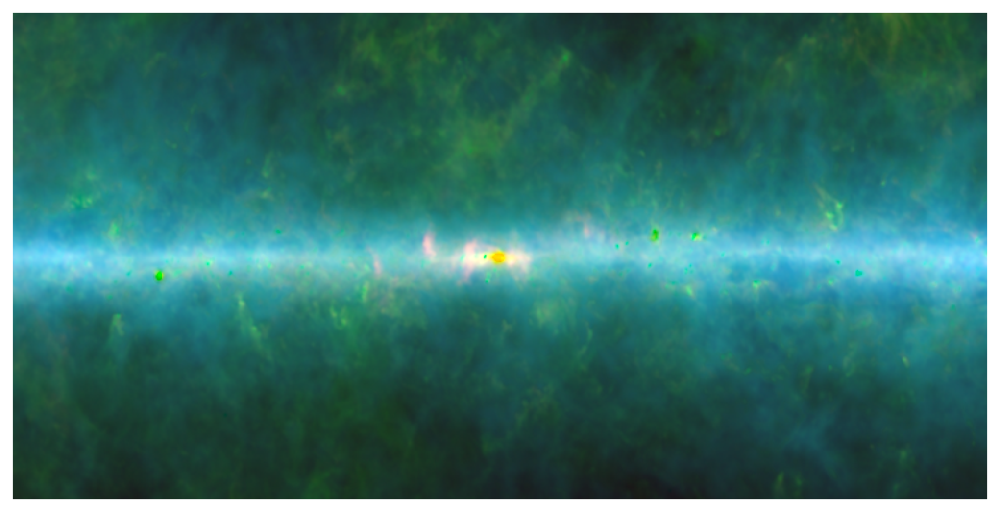

In [150]:
# attempt progressive zoom
import numpy as np
import matplotlib.animation as animation

rgb = np.array([simple_norm(img_HI4PI_cmz,       min_percent=0.01, max_percent=99.99, log_a=1e1, stretch='log')(img_HI4PI_cmz),
                simple_norm(img_CO21_cmz,        min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_CO21_cmz),
                simple_norm(img_ThermalDust_cmz, min_percent=0.01, max_percent=99.99, log_a=5e2, stretch='log')(img_ThermalDust_cmz)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)

fig = pl.figure(figsize=(10,5), dpi=200, frameon=False)
ax = pl.subplot(1,1,1, projection=WCS(target_header_cmz),)
                 #frame_class=EllipticalFrame)
ax.imshow(rgb_scaled)
ax.axis('off')

#ax.set_ylim(120*2, 360*2)
axlims = ax.axis()
cx = np.mean(ax.get_xlim())
cy = np.mean(ax.get_ylim())
dy0 = np.abs(np.diff(ax.get_ylim()))
dx0 = np.abs(np.diff(ax.get_xlim()))

nframes = 90
maxzoom = 5

def animate(n, nframes=nframes):
    
    # lol at math.
    # n = 1 -> denom = 1
    # n = 63 -> denom = 5
    # y = m x + b
    # 5 = m 63 + b
    # 1 = m 1 + b
    # 5 = m 63 + 1 - m
    # m = 4/62
    # b = 58/62
    denom = (maxzoom-1)/(nframes-1) * n + (nframes - maxzoom)/(nframes - 1)
    dy = dy0 * 1/denom
    dx = dx0 * 1/denom
    
    ax.axis((cx-dx, cx+dx, cy-dy, cy+dy))
    print('.', end='')

    return fig,     

anim = animation.FuncAnimation(fig, animate, frames=nframes, repeat_delay=5000,
                              interval=50)
anim.save('zoom_anim_HI-CO-Dust_m0.35.gif')

0:1.0|0:1.0|1:1.1|2:1.1|3:1.2|4:1.2|5:1.3|6:1.3|7:1.4|8:1.4|9:1.5|10:1.5|11:1.6|12:1.6|13:1.7|14:1.7|15:1.8|16:1.8|17:1.9|18:1.9|19:2.0|20:2.0|21:2.1|22:2.1|23:2.2|24:2.2|25:2.3|26:2.3|27:2.4|28:2.4|29:2.5|30:2.5|31:2.6|32:2.6|33:2.7|34:2.7|35:2.8|36:2.8|37:2.9|38:2.9|39:3.0|40:3.0|41:3.1|42:3.1|43:3.2|44:3.2|45:3.3|46:3.3|47:3.4|48:3.4|49:3.5|50:3.5|51:3.6|52:3.6|53:3.7|54:3.7|55:3.8|56:3.8|57:3.9|58:3.9|59:4.0|60:4.0|61:4.1|62:4.1|63:4.2|64:4.2|65:4.3|66:4.3|67:4.4|68:4.4|69:4.5|70:4.5|71:4.6|72:4.6|73:4.7|74:4.7|75:4.8|76:4.8|77:4.9|78:4.9|79:5.0|

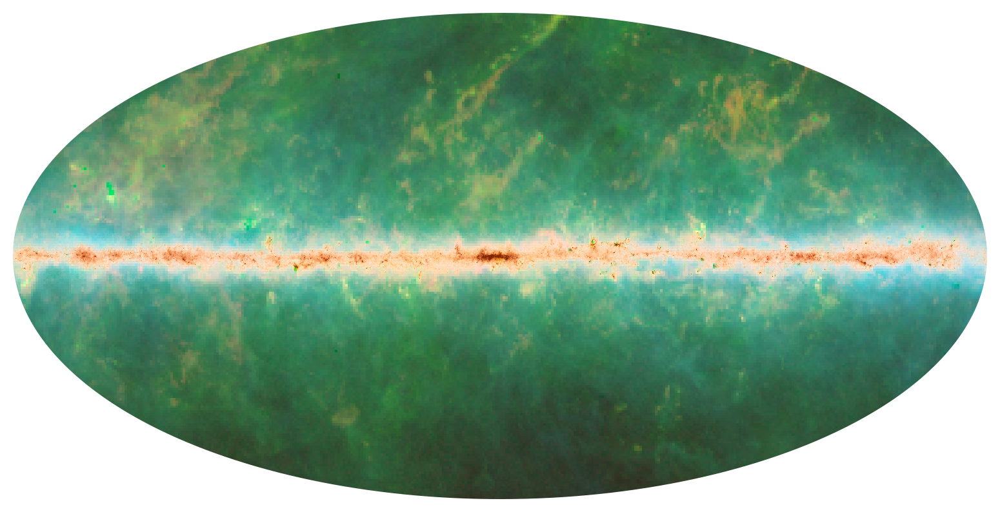

In [151]:
rgb = np.array([simple_norm(img_HI4PI_innergal,       min_percent=0.01, max_percent=99.99, log_a=1e1, stretch='log')(img_HI4PI_innergal),
                simple_norm(img_CO21_innergal,        min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_CO21_innergal),
                simple_norm(img_ThermalDust_innergal, min_percent=0.01, max_percent=99.99, log_a=5e2, stretch='log')(img_ThermalDust_innergal)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)
rgb_scaled[rgb_scaled > 1] = 1
rgb_scaled[rgb_scaled < 0] = 0

rgb_full = np.array([simple_norm(img_HI4PI,       min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_HI4PI),
                     simple_norm(img_CO21,        min_percent=0.01, max_percent=99.90, log_a=2e1, stretch='log')(img_CO21),
                     simple_norm(img_ThermalDust, min_percent=0.01, max_percent=99.90, log_a=5e2, stretch='log')(img_ThermalDust)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb_full)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_full_scaled = hsv_to_rgb(hsv)
rgb_full_scaled[rgb_full_scaled > 1] = 1
rgb_full_scaled[rgb_full_scaled < 0] = 0

fig = pl.figure(figsize=(10,5), dpi=200, frameon=False)
ax = pl.subplot(1,1,1, projection=WCS(target_header),
                frame_class=EllipticalFrame)
ax.imshow(rgb_full_scaled)
ax.axis('off')


nframes = 80
maxzoom = 5

zoomfac = np.hstack([np.linspace(1, 5, nframes//2),
                     np.linspace(1, 5, nframes//2)])
zoomfac = np.linspace(1, maxzoom, nframes)

dy0 = np.abs(np.diff(ax.get_ylim()))/2
dx0 = np.abs(np.diff(ax.get_xlim()))/2
dxdy = [dx0, dy0]
cx = np.mean(ax.get_xlim())
cy = np.mean(ax.get_ylim())

def animate(n, nframes=nframes):
    dx0, dy0 = dxdy
    #if n < nframes // 2:
    #    ax = fig.gca()
    #    cx = np.mean(ax.get_xlim())
    #    cy = np.mean(ax.get_ylim())
    #else:
    #    fig.clf()
    #    ax = pl.subplot(1,1,1, projection=WCS(target_header_innergal),)
    #    ax.imshow(rgb_scaled)
    #    ax.axis('off')
    #    cx = rgb_scaled.shape[1]/2
    #    cy = rgb_scaled.shape[0]/2
    #
    #if n == nframes // 2:
    #    dy0 = rgb_scaled.shape[0]
    #    dx0 = rgb_scaled.shape[1]
    #    dxdy[:] = (dx0, dy0)
    #    print(f"\ndx0,dy0: {dxdy}")
    if n == nframes // 2:
        ax.imshow(atlasgal[0].data,
          norm=simple_norm(atlasgal[0].data, min_percent=5, max_percent=99.9, stretch='asinh'),
          transform=ax.get_transform(WCS(atlasgal[0].header)),
          cmap=orange_transparent)

    dy = dy0 / zoomfac[n]
    dx = dx0 / zoomfac[n]

    ax.axis((cx-dx, cx+dx, cy-dy, cy+dy))
    print(f'{n}:{zoomfac[n]:0.1f}|', end='')

    return fig,     

anim = animation.FuncAnimation(fig, animate, frames=nframes, repeat_delay=5000,
                               interval=50)
anim.save('zoom_anim_molltorect_HI-CO-Dust_m0.35.gif')

0:1.0|0:1.0|1:1.0|2:0.9|3:0.9|4:0.9|5:0.9|6:0.8|7:0.8|8:0.8|9:0.8|10:0.7|11:0.7|12:0.7|13:0.7|14:0.7|15:0.6|16:0.6|17:0.6|18:0.6|19:0.6|20:0.6|21:0.5|22:0.5|23:0.5|24:0.5|25:0.5|26:0.5|27:0.5|28:0.4|29:0.4|30:0.4|31:0.4|32:0.4|33:0.4|34:0.4|35:0.4|36:0.4|37:0.3|38:0.3|39:0.3|40:0.3|41:0.3|42:0.3|43:0.3|44:0.3|45:0.3|46:0.3|47:0.3|48:0.2|49:0.2|50:0.2|51:0.2|52:0.2|53:0.2|54:0.2|55:0.2|56:0.2|57:0.2|58:0.2|59:0.2|60:0.2|61:0.2|62:0.2|63:0.2|64:0.2|65:0.2|66:0.1|67:0.1|68:0.1|69:0.1|70:0.1|71:0.1|72:0.1|73:0.1|74:0.1|75:0.1|76:0.1|77:0.1|78:0.1|79:0.1|80:0.1|81:0.1|82:0.1|83:0.1|84:0.1|85:0.1|86:0.1|87:0.1|88:0.1|89:0.1|90:0.1|91:0.1|92:0.1|93:0.1|94:0.1|95:0.1|96:0.1|97:0.1|98:0.1|99:0.1|100:0.1|101:0.1|102:0.1|103:0.1|104:0.0|105:0.0|106:0.0|107:0.0|108:0.0|109:0.0|110:0.0|111:0.0|112:0.0|113:0.0|114:0.0|115:0.0|116:0.0|117:0.0|118:0.0|119:0.0|120:0.0|121:0.0|122:0.0|123:0.0|124:0.0|125:0.0|126:0.0|127:0.0|128:0.0|129:0.0|130:0.0|131:0.0|132:0.0|133:0.0|134:0.0|135:0.0|136:0.0|137:0.0|

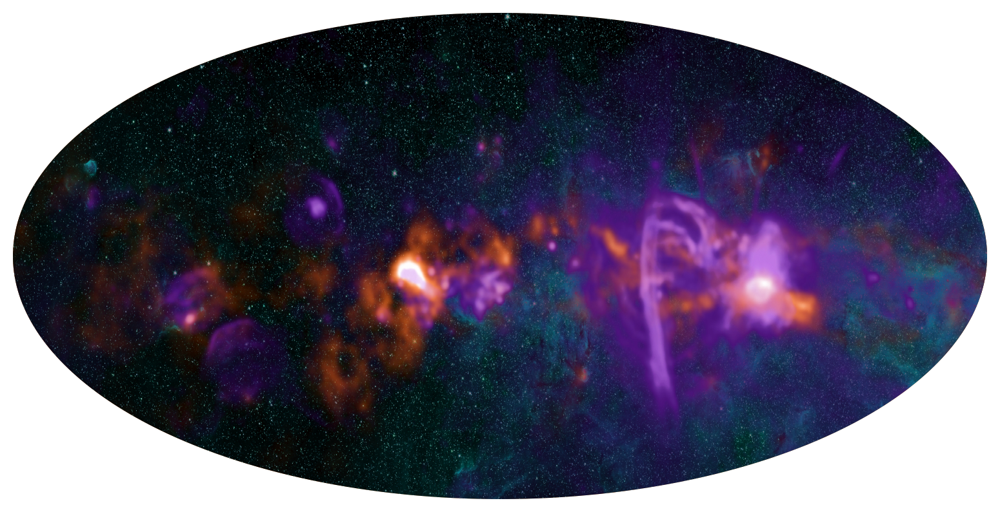

In [161]:
rgb = np.array([simple_norm(img_HI4PI_innergal,       min_percent=0.01, max_percent=99.99, log_a=1e1, stretch='log')(img_HI4PI_innergal),
                simple_norm(img_CO21_innergal,        min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_CO21_innergal),
                simple_norm(img_ThermalDust_innergal, min_percent=0.01, max_percent=99.99, log_a=5e2, stretch='log')(img_ThermalDust_innergal)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)
rgb_scaled[rgb_scaled > 1] = 1
rgb_scaled[rgb_scaled < 0] = 0

rgb_full = np.array([simple_norm(img_HI4PI,       min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_HI4PI),
                     simple_norm(img_CO21,        min_percent=0.01, max_percent=99.90, log_a=2e1, stretch='log')(img_CO21),
                     simple_norm(img_ThermalDust, min_percent=0.01, max_percent=99.90, log_a=5e2, stretch='log')(img_ThermalDust)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb_full)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_full_scaled = hsv_to_rgb(hsv)
rgb_full_scaled[rgb_full_scaled > 1] = 1
rgb_full_scaled[rgb_full_scaled < 0] = 0

fig = pl.figure(figsize=(10,5), dpi=200, frameon=False)
ax = pl.subplot(1,1,1, projection=WCS(target_header),
                frame_class=EllipticalFrame)
ax.imshow(rgb_full_scaled)
ax.axis('off')


nframes = 180
zoomfac = np.geomspace(1, 1/180., nframes)


dy0 = np.abs(np.diff(ax.get_ylim()))/2
dx0 = np.abs(np.diff(ax.get_xlim()))/2
dxdy = [dx0, dy0]
cx = np.mean(ax.get_xlim()) - 2.6 # zoom in between Sgr A and Sgr B2
cy = np.mean(ax.get_ylim())

rgbcmz = np.array(PIL.Image.open('gc_fullres_6.jpg'))[::-1,:,:]
wwcmz = WCS(fits.Header.fromtextfile('gc_fullres_6.wcs'))


def animate(n, nframes=nframes):
    dx0, dy0 = dxdy
    if n == 40:
        ax.imshow(atlasgal[0].data,
          norm=simple_norm(atlasgal[0].data, min_percent=5, max_percent=99.9, stretch='asinh'),
          transform=ax.get_transform(WCS(atlasgal[0].header)),
          cmap=orange_transparent)
    if n == 120:
        ax.imshow(rgbcmz,
          transform=ax.get_transform(wwcmz))
        

    dy = dy0 * zoomfac[n]
    dx = dx0 * zoomfac[n]

    ax.axis((cx-dx, cx+dx, cy-dy, cy+dy))
    print(f'{n}:{zoomfac[n]:0.1f}|', end='')

    return fig,     

anim = animation.FuncAnimation(fig, animate, frames=nframes, repeat_delay=5000,
                               interval=50)
anim.save('zoom_anim_cmz_linear_HI-CO-Dust_m0.35.gif')

0:1.0|0:1.0|1:1.0|2:1.0|3:0.9|4:0.9|5:0.9|6:0.9|7:0.9|8:0.8|9:0.8|10:0.8|11:0.8|12:0.8|13:0.8|14:0.8|15:0.7|16:0.7|17:0.7|18:0.7|19:0.7|20:0.7|21:0.7|22:0.6|23:0.6|24:0.6|25:0.6|26:0.6|27:0.6|28:0.6|29:0.6|30:0.5|31:0.5|32:0.5|33:0.5|34:0.5|35:0.5|36:0.5|37:0.5|38:0.5|39:0.5|40:0.4|41:0.4|42:0.4|43:0.4|44:0.4|45:0.4|46:0.4|47:0.4|48:0.4|49:0.4|50:0.4|51:0.4|52:0.3|53:0.3|54:0.3|55:0.3|56:0.3|57:0.3|58:0.3|59:0.3|60:0.3|61:0.3|62:0.3|63:0.3|64:0.3|65:0.3|66:0.3|67:0.3|68:0.3|69:0.2|70:0.2|71:0.2|72:0.2|73:0.2|74:0.2|75:0.2|76:0.2|77:0.2|78:0.2|79:0.2|

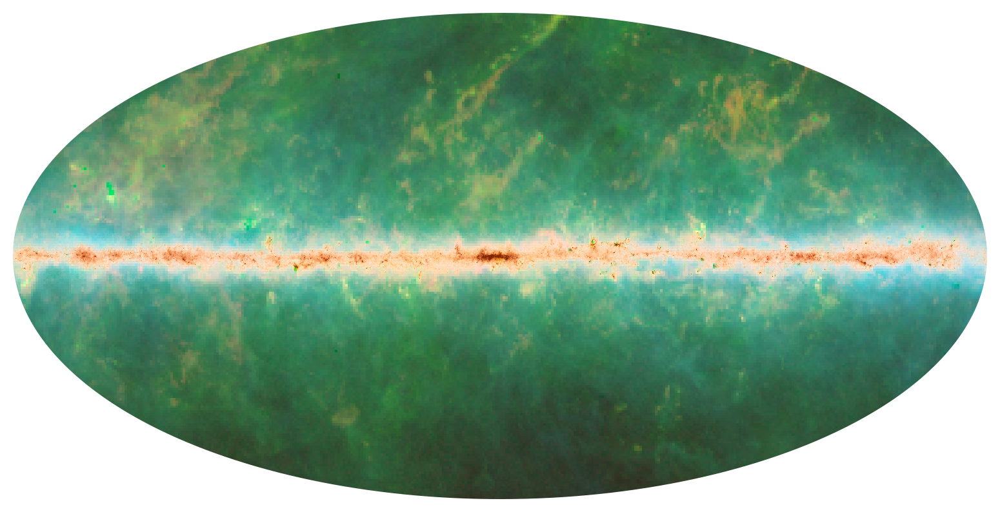

In [158]:
rgb = np.array([simple_norm(img_HI4PI_innergal,       min_percent=0.01, max_percent=99.99, log_a=1e1, stretch='log')(img_HI4PI_innergal),
                simple_norm(img_CO21_innergal,        min_percent=0.01, max_percent=99.99, log_a=3e1, stretch='log')(img_CO21_innergal),
                simple_norm(img_ThermalDust_innergal, min_percent=0.01, max_percent=99.99, log_a=5e2, stretch='log')(img_ThermalDust_innergal)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_scaled = hsv_to_rgb(hsv)
rgb_scaled[rgb_scaled > 1] = 1
rgb_scaled[rgb_scaled < 0] = 0

rgb_full = np.array([simple_norm(img_HI4PI,       min_percent=0.01, max_percent=99.99, log_a=2e1, stretch='log')(img_HI4PI),
                     simple_norm(img_CO21,        min_percent=0.01, max_percent=99.90, log_a=2e1, stretch='log')(img_CO21),
                     simple_norm(img_ThermalDust, min_percent=0.01, max_percent=99.90, log_a=5e2, stretch='log')(img_ThermalDust)]).T.swapaxes(0,1)
hsv = rgb_to_hsv(rgb_full)
hsv[:,:,0] += -0.35  # 0.25 = 90/360
hsv[:,:,0] = hsv[:,:,0] % 1 
rgb_full_scaled = hsv_to_rgb(hsv)
rgb_full_scaled[rgb_full_scaled > 1] = 1
rgb_full_scaled[rgb_full_scaled < 0] = 0

fig = pl.figure(figsize=(10,5), dpi=200, frameon=False)
ax = pl.subplot(1,1,1, projection=WCS(target_header),
                frame_class=EllipticalFrame)
ax.imshow(rgb_full_scaled)
ax.axis('off')


nframes = 80
maxzoom = 5

zoomfac = np.linspace(1, 1/maxzoom, nframes)
zoomfac = np.geomspace(1, 1/maxzoom, nframes)

dy0 = np.abs(np.diff(ax.get_ylim()))/2
dx0 = np.abs(np.diff(ax.get_xlim()))/2
dxdy = [dx0, dy0]
cx = np.mean(ax.get_xlim())
cy = np.mean(ax.get_ylim())

def animate(n, nframes=nframes):
    dx0, dy0 = dxdy
    #if n < nframes // 2:
    #    ax = fig.gca()
    #    cx = np.mean(ax.get_xlim())
    #    cy = np.mean(ax.get_ylim())
    #else:
    #    fig.clf()
    #    ax = pl.subplot(1,1,1, projection=WCS(target_header_innergal),)
    #    ax.imshow(rgb_scaled)
    #    ax.axis('off')
    #    cx = rgb_scaled.shape[1]/2
    #    cy = rgb_scaled.shape[0]/2
    #
    #if n == nframes // 2:
    #    dy0 = rgb_scaled.shape[0]
    #    dx0 = rgb_scaled.shape[1]
    #    dxdy[:] = (dx0, dy0)
    #    print(f"\ndx0,dy0: {dxdy}")
    if n == nframes // 2:
        ax.imshow(atlasgal[0].data,
          norm=simple_norm(atlasgal[0].data, min_percent=5, max_percent=99.9, stretch='asinh'),
          transform=ax.get_transform(WCS(atlasgal[0].header)),
          cmap=orange_transparent)

    dy = dy0 * zoomfac[n]
    dx = dx0 * zoomfac[n]

    ax.axis((cx-dx, cx+dx, cy-dy, cy+dy))
    print(f'{n}:{zoomfac[n]:0.1f}|', end='')

    return fig,     

anim = animation.FuncAnimation(fig, animate, frames=nframes, repeat_delay=5000,
                               interval=50)
anim.save('zoom_anim_molltorect_linear_HI-CO-Dust_m0.35.gif')

# convert zoom_anim_molltorect_HI-CO-Dust_m0.35.gif \( +clone -set delay 500 \) +swap +delete zoom_anim_molltorect_HI-CO-Dust_m0.35_with_pause.gif

In [159]:
sgrc = SkyCoord.from_name('Sgr C')
sgrc

<SkyCoord (ICRS): (ra, dec) in deg
    (266.15125, -29.47028)>

In [ ]:
# check final zoom level
fig = pl.figure(figsize=(10,5), dpi=200, frameon=False)
ax = pl.subplot(1,1,1, projection=WCS(target_header),
                frame_class=EllipticalFrame)
ax.imshow(rgb_full_scaled)
ax.axis('off')

ax.imshow(aces12m[0].data,
             norm=simple_norm(aces12m[0].data, stretch='log',
                              min_percent=None, max_percent=None,
                              min_cut=-0.0005, max_cut=0.05,),
             cmap='gray',
          transform=ax.get_transform(aces12mwcs), )
transorange = pl.cm.Oranges.copy()
transorange.set_under((0,0,0,0))
ax.imshow(aces12m[0].data,
             norm=simple_norm(aces12m[0].data, stretch='asinh',
                              min_percent=None, max_percent=99.99,
                              min_cut=0.05, ),
             cmap=transorange,
          transform=ax.get_transform(aces12mwcs), )

ax.axis([954,957,478,480])

In [ ]:
transorange = pl.cm.Oranges.copy()
transorange.set_under((0,0,0,0))
transorange

In [ ]:
ax.axis([960,963,478,480])
fig

In [ ]:
1920/240

In [155]:
target_header

                                                                                
NAXIS   =                    2                                                  
NAXIS1  =                 1920                                                  
NAXIS2  =                  960                                                  
CTYPE1  = 'GLON-MOL'                                                            
CRPIX1  =                960.5                                                  
CRVAL1  =                  0.0                                                  
CDELT1  =             -0.16875                                                  
CUNIT1  = 'deg     '                                                            
CTYPE2  = 'GLAT-MOL'                                                            
CRPIX2  =                480.5                                                  
CRVAL2  =                  0.0                                                  
CDELT2  =              0.168

# DIRBE:
https://lambda.gsfc.nasa.gov/product/cobe/dirbe_fsm_data_get.html

In [169]:
from hips import WCSGeometry
from astropy.coordinates import SkyCoord

geometry = WCSGeometry.create(
     skydir=SkyCoord(0, 0, unit='deg', frame='galactic'),
     width=1920, height=960, fov="180 deg",
     coordsys='galactic', projection='MOL',
)
hips_survey = 'https://alasky.cds.unistra.fr/2MASS/Color/'
hips_survey = 'CDS/P/2MASS/color'

from hips import make_sky_image
result = make_sky_image(geometry, hips_survey, 'jpg')


Drawing tiles: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:23<00:00,  1.23it/s]


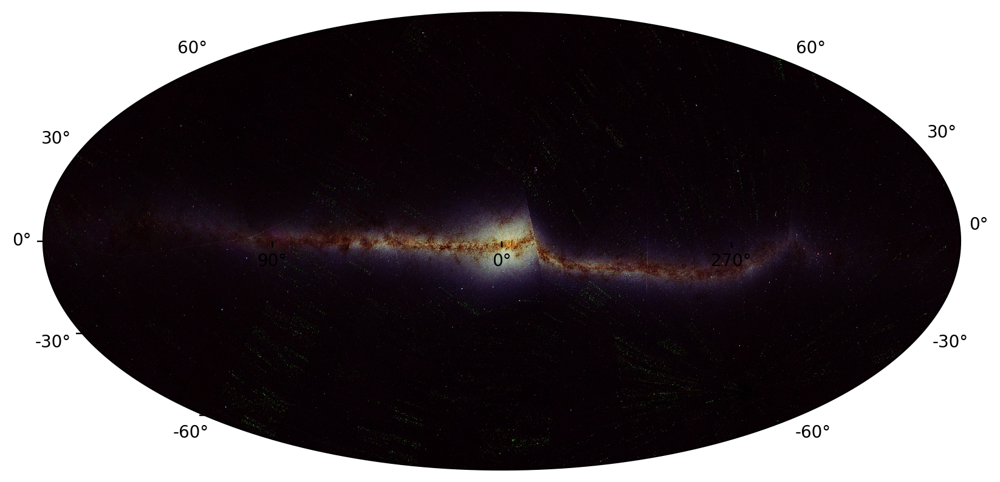

In [170]:
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header),
                 frame_class=EllipticalFrame,
                )
ax.imshow(result.image)

Fetching tiles:   0%|                                                                                                                                                                                                   | 0/29 [00:00<?, ?it/s]


HTTPError: HTTP Error 404: Not Found

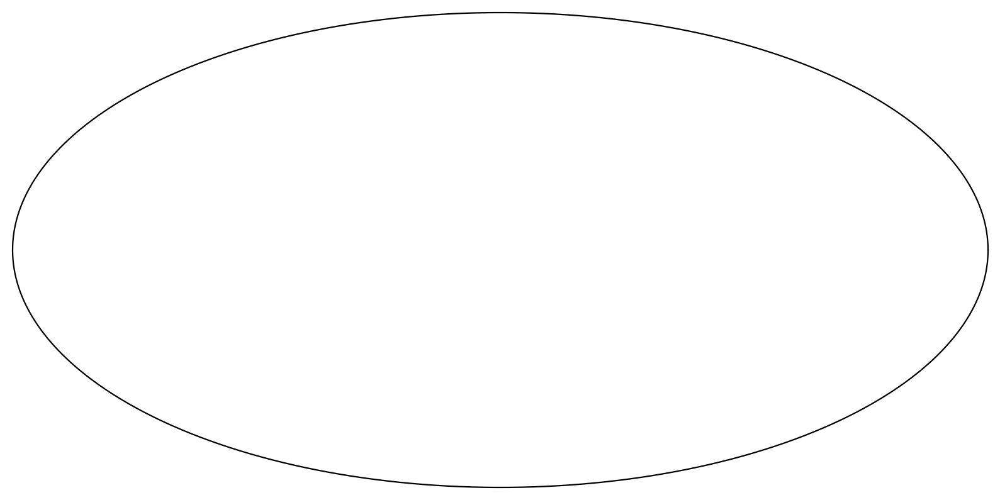

In [168]:
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header),
                 frame_class=EllipticalFrame,
                )
result = make_sky_image(geometry, 'CDS/P/DSS2/color', 'png')
ax.imshow(result.image)
ax.grid(color='w')

In [ ]:
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header),
                 frame_class=EllipticalFrame,
                )
result = make_sky_image(geometry, 'CDS/P/DM/flux-color-Rp-G-Bp/I/350/gaiaedr3', 'png')
ax.imshow(result.image)

In [ ]:
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header),
                 frame_class=EllipticalFrame,
                )
result = make_sky_image(geometry, 'CDS/P/PanSTARRS/DR1/color-z-zg-g', 'fits')
ax.imshow(result.image)

In [ ]:
plt.figure(figsize=(10,5), dpi=200)
ax = plt.subplot(1,1,1, projection=WCS(target_header),
                 frame_class=EllipticalFrame,
                )
result = make_sky_image(geometry, 'CDS/P/allWISE/color', 'fits')
ax.imshow(result.image)